
<span style='font-family: Times; font-size: 2em;'># PTB XL v1.0.3 database exploratory data analysis</span>

**Veronica Ramirez-Lopera** 


### Objectives: 

1. Data Profiling and Familiarization
1. Data quality assessment
1. Trend Identification and Analysis
1. Hypothesis Formulation and Conclusions 


### **Table of contents**

- [Introduction](#introduction)
- [Package Requirements](#package_requirements)
- [Data importing](#importing)
- [Understanding the data](#understanding) 
- [Summarizing the data](#summary) 
    - [Univariate Analysis](#uni) 
    - [Data cleaning](#clean) 
    - [Multivariate analysis](#multi)
- [Automatic profiling](#auto)
- [EKG graphic samples](#samples)
- [ML model attempt](#ML)
- [Conclusions](#conc)
- [References](#ref)



## Introduction <a name='introduction'></a>

PTBXL is a comprehensive dataset, that encompasses 10-second readings from 12 leads of 21,799 Electrocardiograms (ECG) sourced from over 18,800 patients over a span of seven years (1989-1996). Initially compiled as a long-term endeavor by associates at the Physikalisch-Technische Bundesanstalt (PTB), in collaboration with the Technical University of Berlin, this dataset remained confidential until 2019. Subsequently, it was released to the public and has undergone multiple updates aimed at amplifying its versatility for diverse applications, ranging from basic demographic analysis to the refinement of machine learning algorithms. The most recent update was completed on November 9, 2022. Crafted meticulously by an interdisciplinary team comprising cardiologists and biomechanical engineers, this dataset presents an invaluable resource for physicians and data scientists alike.

Throughout this Exploratory Data Analysis (EDA), the focus will be on understanding and preprocessing the data, considering the data collection methodology, patient demographics, and providing insights for potential model development and conclusions.


## Package requirements <a name='package_requirements'></a>


In [1]:
# For basic data description I will be using the pandas and Numpy databases. 
import os
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro
 
# The following packages were suggested by the authors to run the database or to generate the graphs.

import wfdb
import ast
import missingno as msno # To visualize missing value

# Graphs/Misc
import plotly.graph_objects as go # To Generate Graphs
import plotly.express as px # To Generate box plot for statistical representation
%matplotlib inline
import swig # To Generate Graphs
import random # To Generate Random Numbers
from ydata_profiling import ProfileReport # Creates automatic EDA

# To create a very basic ML Random forest algorithm 
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score


## Data importing <a name='importing'></a>

Firstly, we import the datasets provided by the authors. They have shared multiple files for this purpose.

- The initial dataset comprises patient metadata and is stored in ptbxl_database.csv. This dataset will be denoted as 'Y.'
- The second dataset contains raw ECG signal data and resides within the high-resolution - 500 HZ folder. We will refer to this dataset as 'X.'
- Lastly, the dataset containing SCP statements for each patient is found in the scp_statements.csv file. These statements will be integrated into the Y dataframe.

_Disclaimer:_ The majority of the data importing code was suggested by Wagner et al (1). I used a relative path to the database to run the code.


In [13]:
# Loading the Raw data  

def load_raw_data(df, sampling_rate, path):
    if sampling_rate == 100:
        data = [wfdb.rdsamp(path +f) for f in df.filename_lr]
    else:
        data = [wfdb.rdsamp(path+f) for f in df.filename_hr]
    data = np.array([signal for signal, meta in data])
    return data

path = './PTBXL/' # Might need to change the path!
sampling_rate=100

# Load and convert annotation data
Y = pd.read_csv(path+'ptbxl_database.csv', index_col='ecg_id')
Y.scp_codes = Y.scp_codes.apply(lambda x: ast.literal_eval(x))

# Load raw signal data
X = load_raw_data(Y, sampling_rate, path)

# Load scp_statements.csv for diagnostic aggregation
agg_df = pd.read_csv(path+ 'scp_statements.csv', index_col=0)
agg_df = agg_df[agg_df.diagnostic == 1]


def aggregate_diagnostic(y_dic):
    tmp = []
    for key in y_dic.keys():
        if key in agg_df.index:
            tmp.append(agg_df.loc[key].diagnostic_class)
    return list(set(tmp))

# Apply diagnostic superclass
Y['diagnostic_superclass'] = Y.scp_codes.apply(aggregate_diagnostic)

# Apply diagnostic subclass
def aggregate_subclass_diagnostic(y_dic):
    tmp = []
    for key in y_dic.keys():
        if key in agg_df.index:
            tmp.append(agg_df.loc[key].diagnostic_subclass)
    ret = list(set(tmp))
    ret = ['sub_'+r for r in ret] # to distinguish between subclass and superclass columns
    return ret

Y['diagnostic_subclass'] = Y.scp_codes.apply(aggregate_subclass_diagnostic)

# Split data into train and test
test_fold = 10
# Train
X_train = X[np.where(Y.strat_fold != test_fold)]
y_train = Y[(Y.strat_fold != test_fold)].diagnostic_superclass
# Test
X_test = X[np.where(Y.strat_fold == test_fold)]
y_test = Y[Y.strat_fold == test_fold].diagnostic_superclass

# Understanding/Cleaning the Data <a name='understanding'></a>

Now, lets take a look at our variables

- Y: DataFrame 
- X: Raw data.
- x_train & x_test: Raw data split into train and test sets, divided by the stratified folds suggested by the authors.
- y_train & y_test: Diagnostic superclass split into train and test sets, divided by the stratified folds suggested by the authors.

Firstly, let's ensure that the number of records matches across these variables.

In [ ]:
print(Y.shape, X.shape, X_train.shape, X_test.shape)

# Y is a dataframe, X is an nparray includes all the raw data. Lets see if the number of registries match. 
index_match = bool(Y.shape[0] == X.shape[0])

if index_match == True:
    print('X y Y have the same number of registries')


(21799, 29) (21799, 1000, 12) (19601, 1000, 12) (2198, 1000, 12)
X y Y have the same number of registries


In [ ]:


# Lets visualize our dataframes
Y.columns
Y.head()


,patient_id,age,sex,height,weight,nurse,site,device,recording_date,report,...,static_noise,burst_noise,electrodes_problems,extra_beats,pacemaker,strat_fold,filename_lr,filename_hr,diagnostic_superclass,diagnostic_subclass
ecg_id,,,,,,,,,,,,,,,,,,,,,
1,15709.0,56.0,1,NaN,63.0,2.0,0.0,CS-12 E,1984-11-09 09:17:34,sinusrhythmus periphere niederspannung,...,", I-V1,",NaN,NaN,NaN,NaN,3,records100/00000/00001_lr,records500/00000/00001_hr,[NORM],[sub_NORM]
2,13243.0,19.0,0,NaN,70.0,2.0,0.0,CS-12 E,1984-11-14 12:55:37,sinusbradykardie sonst normales ekg,...,NaN,NaN,NaN,NaN,NaN,2,records100/00000/00002_lr,records500/00000/00002_hr,[NORM],[sub_NORM]
3,20372.0,37.0,1,NaN,69.0,2.0,0.0,CS-12 E,1984-11-15 12:49:10,sinusrhythmus normales ekg,...,NaN,NaN,NaN,NaN,NaN,5,records100/00000/00003_lr,records500/00000/00003_hr,[NORM],[sub_NORM]
4,17014.0,24.0,0,NaN,82.0,2.0,0.0,CS-12 E,1984-11-15 13:44:57,sinusrhythmus normales ekg,...,NaN,NaN,NaN,NaN,NaN,3,records100/00000/00004_lr,records500/00000/00004_hr,[NORM],[sub_NORM]
5,17448.0,19.0,1,NaN,70.0,2.0,0.0,CS-12 E,1984-11-17 10:43:15,sinusrhythmus normales ekg,...,NaN,NaN,NaN,NaN,NaN,4,records100/00000/00005_lr,records500/00000/00005_hr,[NORM],[sub_NORM]


In [ ]:
# Let's Rename gender for better visualization
Y['sex'] = Y['sex'].replace({0: 'Male', 1: 'Female'})

# Lets generate a copy to keep the original data
Y_copy = Y.copy()

# Lets observe every assigned class for each column to see if the data type is correct, and the number of registries for each class.  
Y.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21799 entries, 1 to 21837
Data columns (total 29 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   patient_id                    21799 non-null  float64
 1   age                           21799 non-null  float64
 2   sex                           21799 non-null  object 
 3   height                        6974 non-null   float64
 4   weight                        9421 non-null   float64
 5   nurse                         20326 non-null  float64
 6   site                          21782 non-null  float64
 7   device                        21799 non-null  object 
 8   recording_date                21799 non-null  object 
 9   report                        21799 non-null  object 
 10  scp_codes                     21799 non-null  object 
 11  heart_axis                    13331 non-null  object 
 12  infarction_stadium1           5612 non-null   object 
 13  infarc

In [ ]:
# Identifying and Visualizing the missing values 
Y.isnull().sum()

patient_id                          0
age                                 0
sex                                 0
height                          14825
weight                          12378
nurse                            1473
site                               17
device                              0
recording_date                      0
report                              0
scp_codes                           0
heart_axis                       8468
infarction_stadium1             16187
infarction_stadium2             21696
validated_by                     9378
second_opinion                      0
initial_autogenerated_report        0
validated_by_human                  0
baseline_drift                  20201
static_noise                    18539
burst_noise                     21186
electrodes_problems             21769
extra_beats                     19850
pacemaker                       21508
strat_fold                          0
filename_lr                         0
filename_hr 

<Axes: >

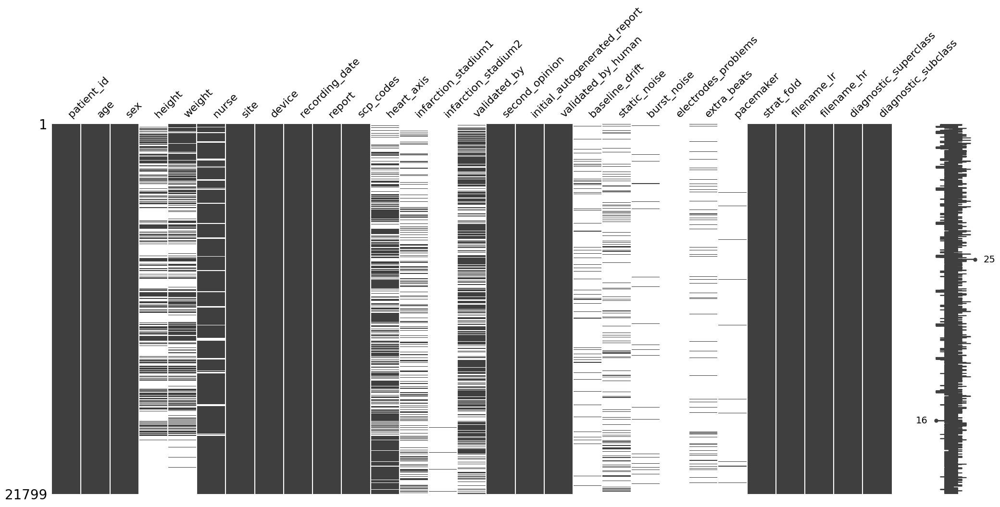

In [ ]:
msno.matrix(Y)


Observations:

All columns have their intended data types.

The dataset comprises 29 columns and 21,837 records, aligning with the number of raw data records and ECGs as stated in the article. The columns encompass metadata about patients, signals, reports, as well as assigned classes and subclasses.

The 'report' column underwent translation from German, Swedish, and English to a common language (English). The 'scp_codes' column contains the manual conversion of reports into a common language. However, this process, given the volume of records, may be prone to errors. The diagnostic superclass and subclass columns serve as labels for the ECGs, intended for training classification algorithms.

A substantial number of missing values are present, particularly in signal metadata columns. These missing values are not random; they pertain to signal quality and baseline drift. The authors clarified that an expert annotated abnormalities throughout the dataset, with empty records indicating high-quality readings without signal concerns.

Categories with the highest number of missing values relate to signal metadata such as baseline drift and signal quality. This absence of data stems from the expert annotation process, where high-quality readings with no signal concerns resulted in empty records.

Some general metadata, notably height and weight, are missing, potentially impacting future predictions using this dataset. The authors attribute this to changes in the data acquisition process over time, with physical metadata being collected more frequently at the beginning of the study.

The 'heart_axis' was automatically extracted from ECG reports. However, there is no explanation provided for the missing values, which could pose challenges for future analyses.

The 'pacemaker' column exhibits a significant number of missing values.


## Identifying and deleting duplicate records <a name='cleaning'></a>

The initial step involves detecting and removing duplicate entries within the dataset. However, a challenge arises due to the presence of unhashable data types among the variables. To address this and enable efficient iteration for duplicate checking, we will convert all collections to strings.

In [ ]:
#To identify duplicate records, excluding patients with multiple ECGs, we need to address the unhashable columns issue, hindering the use of the duplicates() function directly
# This problem stems from having multiple columns containing unhashable types, such as collections.
# We can identify these problematic columns by examining the unique types of items in each column.

# A column containing more than one class indicates the presence of a collection, making it unhashable for direct duplicate detection using the duplicates() function. Lets identify the columns with collections:

collection_types = {} # Lets store the unique types for each column

for column in Y.columns:
    # Identify unique types in the column
    unique_types = set(type(item) for item in Y[column])
    
    # Store the unique types
    collection_types[column] = unique_types

# Display the unique types for each column in a dataframe and change the names of the columns in said dataframe
unique_class = pd.DataFrame(collection_types.items())
unique_class.rename(columns = {0: 'Column', 1: 'Unique Types'}, inplace = True)
print(unique_class)


                          Column                      Unique Types
0                     patient_id                 {<class 'float'>}
1                            age                 {<class 'float'>}
2                            sex                   {<class 'str'>}
3                         height                 {<class 'float'>}
4                         weight                 {<class 'float'>}
5                          nurse                 {<class 'float'>}
6                           site                 {<class 'float'>}
7                         device                   {<class 'str'>}
8                 recording_date                   {<class 'str'>}
9                         report                   {<class 'str'>}
10                     scp_codes                  {<class 'dict'>}
11                    heart_axis  {<class 'float'>, <class 'str'>}
12           infarction_stadium1  {<class 'float'>, <class 'str'>}
13           infarction_stadium2  {<class 'float'>, <class 'st

In [ ]:
# Now, lets convert the unhashable objects to strings

for column in Y.columns:
    if any(isinstance(item, (dict, list, set)) for item in Y[column]):
        Y[column] = Y[column].astype(str)


# Finally, check for duplicates 
duplicates = Y.duplicated().sum()

if duplicates:
    print('The following records are duplicated {}'.format(duplicates) )
else:
    print('No duplicates detected, no need to drop any records') 

No duplicates detected, no need to drop any records


## Summarizing the data: <a name='summary'></a>

The continuous variables that were included in the dataframe were:

-  Age
- Height
- Weight

Notes:

- There are patients with more than 1 EKG records. I will delete patient duplicates before the descriptive analysis of the demographic metadata to avoid bias. For model predictions we will use the original dataset stored in Y_copy.
- The height values for patients where the body-mass-index calculated from height and weight was larger than 40 were REMOVED by the authors. 
- Due to HIPAA regulations (identity masking), the authors of the database automatically set the age of every person >=90 years old to 300. 

First, Lets summarize the continuous variables and visualize the categorical variables. 




## Univariate analysis <a name='uni'></a>

### Quantitative <a name='quantitative'></a>

In [ ]:
# Univariate analysis - Quantitative Variables

# First, we have to remove the duplicate patients (Those with more than 1 ECG record). We will create a filtered dataframe. 
Y_no_duplicates = Y.drop_duplicates(subset=['patient_id'])

# Lets count the amount of subjects older than 90
elderly = len(Y_no_duplicates[Y_no_duplicates['age']> 90])
print('There are {} patients over 90 years old'.format(elderly))

# For the age variable, I will separate from the analysis all the patients that are 90 or older, as they were masked and can skew the results.
age_filter = Y_no_duplicates[Y_no_duplicates['age'] < 90]

# Now, for everyone younger than 90, we can proceed with the analysis.
age_filter_cols = age_filter[['age','height', 'weight']].copy()
age_filter_cols.rename(columns={'height': 'Height in cms', 'Weight': 'weight in kgs', 'age': 'Age'}, inplace=True)

age_filter_cols.describe()


There are 257 patients over 90 years old


,Age,Height in cms,weight
count,18612.000000,6485.000000,8690.000000
mean,59.083602,166.928913,71.242808
std,16.976159,10.877495,15.682184
min,2.000000,6.000000,5.000000
25%,49.000000,160.000000,60.000000
50%,61.000000,167.000000,70.000000
75%,72.000000,175.000000,80.000000
max,89.000000,209.000000,250.000000


c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning

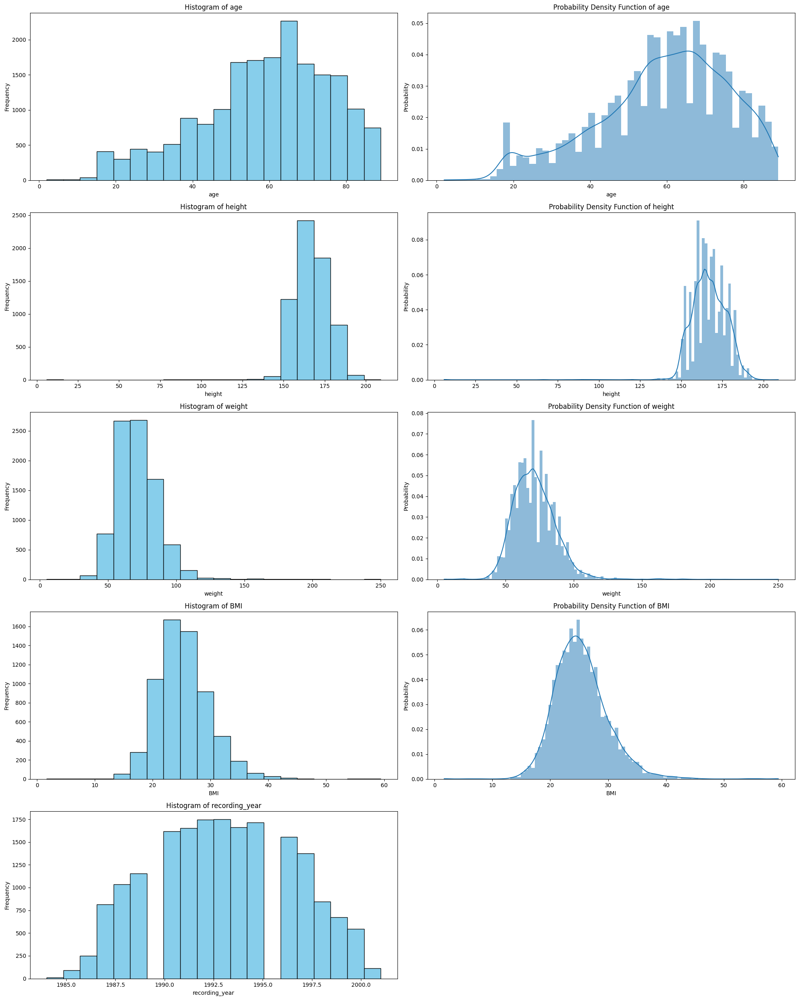

In [ ]:
#Lets plot the age, height, weight and recording year (The authors randomized the year for it to comply with HIPAA, whilst maintaining the integrity of the dataset)

age_filter = age_filter.copy()

# Extract the year from the recording date
age_filter['recording_date'] = pd.to_datetime(age_filter['recording_date'])
age_filter['recording_year'] = age_filter['recording_date'].dt.year

# Calculate the BMI and add it to the dataframe
age_filter['BMI'] = age_filter['weight'] / (age_filter['height']/100)**2
age_filter['BMI'].describe()

# Select the columns
columns = ['age', 'height', 'weight', 'BMI', 'recording_year' ]

# Plot both histogram and probability distribution function (PDF) for each column
plt.figure(figsize=(20, 5 * len(columns)))

for i, column in enumerate(columns, 1):
    plt.subplot(len(columns), 2, 2*i-1)  # Histogram subplot
    plt.hist(age_filter[column], bins=20, color='skyblue', edgecolor='black')
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    
    if column == 'recording_year':
        pass
    else:
        plt.subplot(len(columns), 2, 2*i)  # PDF subplot
        sns.histplot(data=age_filter, x=column, kde=True, stat='probability', linewidth=0)
        plt.title(f'Probability Density Function of {column}')
        plt.xlabel(column)
        plt.ylabel('Probability')

plt.tight_layout()
plt.show()

In [ ]:
# Lets perform a Shapiro-Wilk test to check if the data is normally distributed

# Select the columns of interest
columns = ['age', 'height', 'weight']

# Perform Shapiro-Wilk test for each column
for column in columns:
    stat, p_value = shapiro(age_filter[column])
    print(f'Shapiro-Wilk Test for {column}:')
    print(f'  Test Statistic: {stat}')
    print(f'  p-value: {p_value}')
    if p_value > 0.05:
        print('  The data appears to be normally distributed (p > 0.05)\n')
    else:
        print('  The data does not appear to be normally distributed (p <= 0.05)\n')

        
        

Shapiro-Wilk Test for age:
  Test Statistic: 0.9695413708686829
  p-value: 0.0
  The data does not appear to be normally distributed (p <= 0.05)

Shapiro-Wilk Test for height:
  Test Statistic: nan
  p-value: 1.0
  The data appears to be normally distributed (p > 0.05)

Shapiro-Wilk Test for weight:
  Test Statistic: nan
  p-value: 1.0
  The data appears to be normally distributed (p > 0.05)



c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


Observations: 

1. Patient Demographics

The age distribution in the PTB-XL dataset is skewed towards older adults. While the average age is 59 with a standard deviation of 16.9 years, indicating a range of 42 to 76 years old for most patients, this skews considerably higher than the average life expectancy in Berlin during the recording period (75.98 years in 1996) [4]. This trend is similar to current life expectancy in North America (76.4 years) [5].  This focus on older patients might limit the generalizability of future models trained on this data to younger populations.  Future ECG databases should strive for a more balanced age distribution to improve generalizability. Additionally, it's important to consider that age is an independent risk factor for cardiovascular disease [6], potentially inflating the observed prevalence of these conditions within this dataset.

2. Height and Weight
Both height and weight in the PTB-XL dataset appear to follow a normal distribution. However, it's crucial to note that the data source excluded height measurements for patients with a Body Mass Index (BMI) exceeding 40. This exclusion might introduce bias in any analysis involving height or BMI calculations. 


# Outliers and data cleaning <a name='clean'></a>

Addressing Outliers in Age

Our data visualizations revealed outliers within the age distribution, particularly for older patients. Since age skews towards the elderly and is a key concern, we'll focus on outlier treatment for this variable.

Leveraging Interquartile Range (IQR)

To address these outliers in a structured manner, we'll employ the Interquartile Range (IQR) method. This technique identifies outliers as data points falling outside a specific range based on the distribution's quartiles.  We'll utilize the IQR to pinpoint and potentially remove outliers in the age data while minimizing data loss.

        patient_id   age     sex  height  weight  nurse  site      device  \
ecg_id                                                                      
1          15709.0  56.0  Female     NaN    63.0    2.0   0.0   CS-12   E   
2          13243.0  19.0    Male     NaN    70.0    2.0   0.0   CS-12   E   
3          20372.0  37.0  Female     NaN    69.0    2.0   0.0   CS-12   E   
4          17014.0  24.0    Male     NaN    82.0    2.0   0.0   CS-12   E   
5          17448.0  19.0  Female     NaN    70.0    2.0   0.0   CS-12   E   
...            ...   ...     ...     ...     ...    ...   ...         ...   
21832       7954.0  63.0    Male     NaN     NaN    1.0   2.0  AT-60    3   
21833      17180.0  67.0  Female     NaN     NaN    1.0   2.0  AT-60    3   
21835      19311.0  59.0  Female     NaN     NaN    1.0   2.0  AT-60    3   
21836       8873.0  64.0  Female     NaN     NaN    1.0   2.0  AT-60    3   
21837      11744.0  68.0    Male     NaN     NaN    1.0   2.0  AT-60    3   

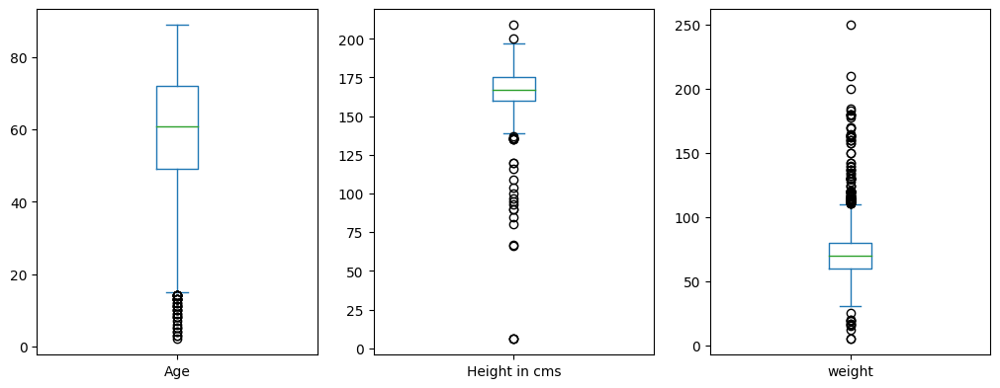

In [ ]:

# Lets visualize the outliers in our quantitative data.

age_filter_cols.plot(kind='box', subplots= True, layout=(2,7), sharex=False,sharey=False, figsize=(30, 10))

# First, we have to make a function that quantifies the Q1 and Q3 quartiles, defines the Interquatile Range (Q3 - Q1) and cleans the dataframe. 
# I will use the original dataframe, not the filtered one. 

def remove_outliers(Y, columns):
    for col in columns:
        q1 = Y[col].quantile(0.25)
        q3 = Y[col].quantile(0.75)
        iqr = q3 - q1
        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr
        
        # Only remove outliers for non-missing values. It leaves all the patients that didnt get height or weight registered. 
        Y = Y[((Y[col] >= lower_bound) & (Y[col] <= upper_bound)) | Y[col].isnull()]
    return Y

# Categories to check for outliers 
quantitative_data = ['age', 'weight', 'height']

# Remove outliers
Y = remove_outliers(Y, quantitative_data)

# Display the clean DataFrame
print(Y)

##  Qualitative data <a name='qualitative'></a>

For our qualitative analysis, we will focus on several important categorical variables, which include:

- Diagnostic Superclass: Standardized reports providing diagnostic impressions.
- Diagnostic Subclass: More detailed diagnostic information.
- Infarction Stadium (only applicable for superclass: MI).
- Device used for recording the EKG.
- Active Pacemaker status.
- Heart Axis, with categories such as Unknown (UNK), Normal (MID), Left Axis Deviation (LAD), Abnormal Left Axis Deviation (ALAD), Right Axis Deviation (RAD), Abnormal Right Axis Deviation (ARAD), Horizontal Axis (AXL), Vertical Axis (AXR), and Saggital Type (SAG, with S1-S2-S3 Pattern).

We will now proceed to analyze and visualize these categorical variables.



Frequency of Sex:
      sex  Frequency
0    Male      11149
1  Female      10124

Frequency of Nurse:
    nurse  Frequency
0     0.0       8212
1     1.0       5569
2     2.0        630
3     5.0        616
4     7.0        614
5     3.0        614
6    10.0        603
7     4.0        603
8    11.0        600
9     8.0        598
10    6.0        597
11    9.0        587

Frequency of Site:
    site  Frequency
0    0.0       8848
1    1.0       6020
2    2.0       4958
3    3.0        569
4    4.0         97
5    5.0         55
6    6.0         45
7    8.0         42
8    7.0         41
9    9.0         37
10  10.0         35
11  11.0         31
12  14.0         26
13  12.0         25
14  13.0         23
15  15.0         22
16  16.0         21
17  17.0         20
18  21.0         18
19  18.0         17
20  20.0         17
21  23.0         15
22  22.0         15
23  28.0         15
24  27.0         15
25  29.0         14
26  26.0         14
27  19.0         14
28  32.0         13
29  3

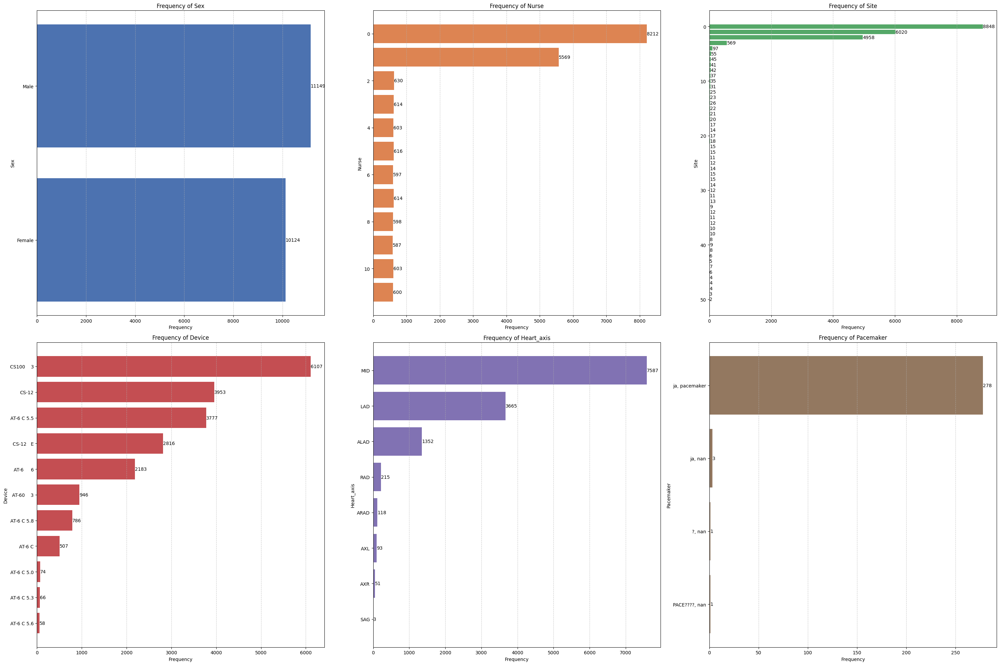

In [ ]:
# Define categorical variables
categorical_vars = ['sex', 'nurse', 'site', 'device', 'heart_axis', 'pacemaker']

# Set up the plot grid
plt.figure(figsize=(30, 20))

# Define colors for the gradient
colors = sns.color_palette('deep', n_colors=len(categorical_vars))

for i, var in enumerate(categorical_vars, 1):
    # Calculate frequencies of each category
    category_counts = Y[var].value_counts()
    categories = category_counts.index
    counts = category_counts.values
    
    # Create and print a data frame with the frequencies
    category_df = pd.DataFrame({var: categories, 'Frequency': counts})
    print(f'Frequency of {var.capitalize()}:\n{category_df}\n')
    
    # Create a horizontal bar plot with gradient colors
    plt.subplot(2, 3, i)
    bars = plt.barh(categories, counts, color=colors[i-1])
    
    # Add data labels
    for bar, count in zip(bars, counts):
        plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{count}', 
                 va='center', ha='left', fontsize=10, color='black')
    
    plt.title(f'Frequency of {var.capitalize()}')
    plt.xlabel('Frequency')
    plt.ylabel(var.capitalize())
    plt.gca().invert_yaxis()  # Invert y-axis to display categories from top to bottom
    plt.grid(axis='x', linestyle='--', alpha=0.7)  # Add grid lines for better readability

plt.tight_layout()
plt.show()


Observations:

- Sex Variable: There exists a balanced distribution between females and males, albeit with a slight predominance of males.

- Nurse Variable: Notably, two nurses exhibit a significantly higher number of records compared to others.  The significance of this observation will become apparent in the subsequent multivariate and correlation analyses.

- Site Variable: The data reveals that the majority of records originate from three specific sites, with the remaining sites contributing substantially fewer records.

- Device Variable: Analysis indicates the utilization of 11 distinct models for ECG recording, with a substantial portion of records attributed to the CS100 model.

- Heart_axis Variable: The majority of records demonstrate a normal heart axis, followed by instances of left axis deviation and extreme left axis deviation.

- Pacemaker: The authors state that 1.34% of records have an active pacemaker [1]. Nevertheless, the annotations in the pacemaker column are confusing, and they are not adequately explained in the article. Prediction models should refrain from using the pacemaker column as a feature. 

Infarction stadium: 

- Stadium I acute, early 
- Stadium I–II acute/subacute, ablaufend 
- Stadium II recent, subacute, bereits abgelaufen 
- Stadium II–III subacute/chronisch 
- Stadium III old, abgelaufen, chronisch  
- unknown uncertain, unknown, unbekannt


          Stadium  Frequency
0         unknown       3356
1     Stadium III        982
2  Stadium II-III        933
3       Stadium I        180
4      Stadium II        103
5    Stadium I-II          5


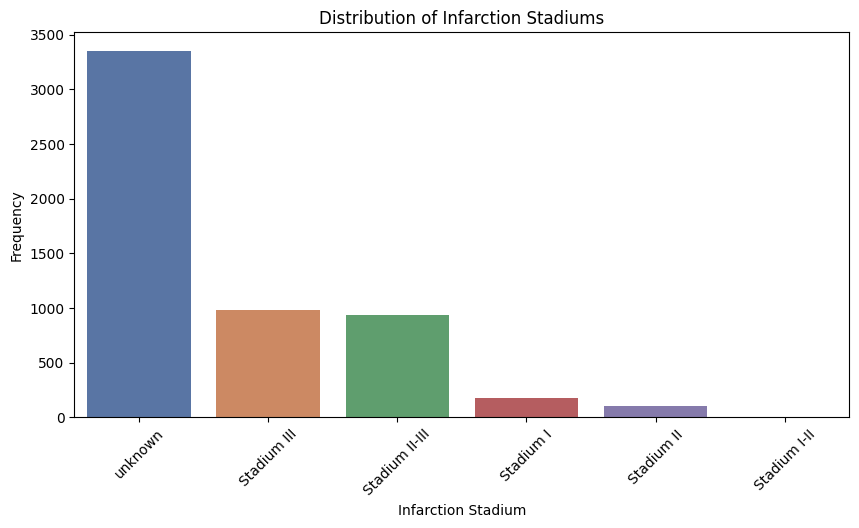

In [ ]:
# Lets tabulate the distribution of the infarction stadiums across the database 

# Concatenate infarction_stadium1 and infarction_stadium2, then count unique values
unique_stadiums = pd.concat([Y['infarction_stadium1'], Y['infarction_stadium2']]).value_counts().reset_index()
unique_stadiums.columns = ['Stadium', 'Frequency']
print(unique_stadiums)

# Plot the distribution of infarction stadiums
plt.figure(figsize=(10, 5))
sns.barplot(data=unique_stadiums, x= 'Stadium', y='Frequency', palette='deep')
plt.title('Distribution of Infarction Stadiums')
plt.xlabel('Infarction Stadium')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()




For patients with infarction, a notable portion of subjects have an unknown stage, suggesting uncertainty regarding the temporal aspect of the infarction. This underscores the need for cautious approach in developing predictive models for infarction, particularly given the relatively limited number of patients with detailed infarction stage data in this database. It is unlikely that the available data is comprehensive enough to generate reliable stage predictions at all.

## Superclasses and subclasses

This category is a bit more challenging, as both columns values are originally presented as lists, which are also unhashable objects. My workaround involved converting the values to strings, deleting all the square brackets and separating each superclass by commas. 

In [ ]:
# Let's visualize in a table all the superclasses and their percentages.

# First, group the superclass values
superclasses = Y['diagnostic_superclass'].apply(pd.Series).stack().reset_index(drop=True).astype(str)

# Count how many empty classes are there
empty_superclass = (superclasses == '[]').sum()
print('There are {} empty superclasses.'.format(empty_superclass))

# Remove the empty classes for superclass analysis and count the frequency of each superclass.
superclasses = superclasses[superclasses != '[]']
superclasses = superclasses.str.strip('[]').str.split(',').explode().str.strip().value_counts()

# Convert series to DataFrame and add up the total frequencies
superclasses_df = superclasses.rename_axis('Superclass').reset_index(name='Frequency')
total_frequency = superclasses_df['Frequency'].sum()

# Add percentage column
superclasses_df['Percentage'] = superclasses_df['Frequency'] / total_frequency * 100

# Sort DataFrame by superclass
superclasses_df = superclasses_df.sort_values(by='Percentage', ascending=False)

superclasses_df

There are 403 empty superclasses.


,Superclass,Frequency,Percentage
0,'NORM',9333,34.574350
1,'MI',5319,19.704379
2,'STTC',5061,18.748611
3,'CD',4715,17.466844
4,'HYP',2566,9.505816


As stated in the article, the empty classes are predominantly associated with pacemakers. However, it's worth noting that some patients with pacemakers do have a superclass. This finding lacks any explanation or justification. Said inconsistency could introduce inaccuracies in future predictions. It provides another rationale for refraining from utilizing the dataset for pacemaker predictions.

The predominant superclass is NORM, representing normal ECG readings. Following NORM, the most frequently observed abnormalities were MI (Myocardial Infarction), STTC (ST-T Change), and CD (Conduction Disturbance). Conversely, the least common abnormality was HYP (Hypertrophy).

Analysis:

The study "Major electrocardiographic abnormalities in persons aged 65 years and older (the Cardiovascular Health Study)" published around 1992 in the USA, involved a population of 5150 adults, revealing that 28.75% of them had abnormal EKGs. The most prevalent abnormalities were ventricular conduction defects, followed by STTC, past infarctions, and left ventricular hypertrophy [7].

Comparing the distribution of the PTB XL dataset to the US population at that time, there's a similarity, although the dataset exhibits a slightly lower proportion of normal EKGs compared to clinical practice. This suggests good generalizability of the dataset. However, the notably low percentage of ventricular hypertrophy records, approximately 2000 records fewer than the preceding category, may raise concerns for future predictions.



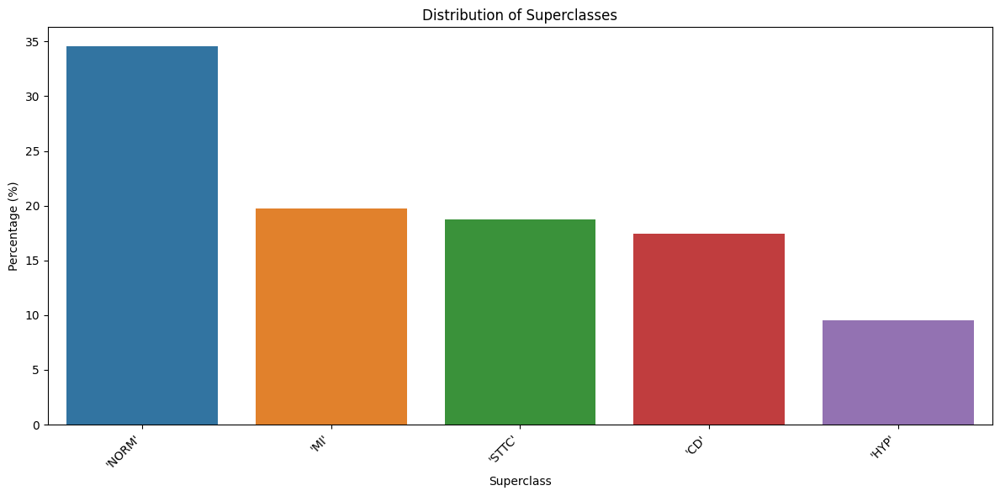

In [ ]:
# Plot the distribution of the superclasses

plt.figure(figsize=(12, 6))
sns.barplot(x='Superclass', y='Percentage', data=superclasses_df)
plt.xlabel('Superclass')
plt.ylabel('Percentage (%)')
plt.title('Distribution of Superclasses')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


Now, lets analyze all the subclasses

In [ ]:
# Let's visualize in a table all the superclasses and their percentages.

# First, group the superclass values
subclasses = Y['diagnostic_subclass'].apply(pd.Series).stack().reset_index(drop=True).astype(str)

# Count how many empty classes are there
empty_subclass = (subclasses == '[]').sum()
print('There are {} empty subclasses.'.format(empty_subclass))

# Remove the empty classes for superclass analysis and count the frequency of each superclass.
subclasses = subclasses[subclasses != '[]']
subclasses = subclasses.str.strip('[]').str.split(',').explode().str.strip().value_counts()

# Convert series to DataFrame and add up the total frequencies
subclasses_df = subclasses.rename_axis('Subclass').reset_index(name='Frequency')
total_frequency = subclasses_df['Frequency'].sum()

# Add percentage column
subclasses_df['Percentage'] = subclasses_df['Frequency'] / total_frequency * 100

# Sort DataFrame by superclass
subclasses_df = subclasses_df.sort_values(by='Percentage', ascending=False)

subclasses_df

There are 403 empty subclasses.


,Subclass,Frequency,Percentage
0,'sub_NORM',9333,31.742739
1,'sub_IMI',3198,10.876811
2,'sub_AMI',2971,10.104755
3,'sub_STTC',2160,7.346439
4,'sub_LVH',2070,7.040337
5,'sub_LAFB/LPFB',1726,5.870349
6,'sub_ISC_',1227,4.173185
7,'sub_IRBBB',1078,3.666417
8,'sub_ISCA',916,3.115434
9,'sub__AVB',788,2.680090


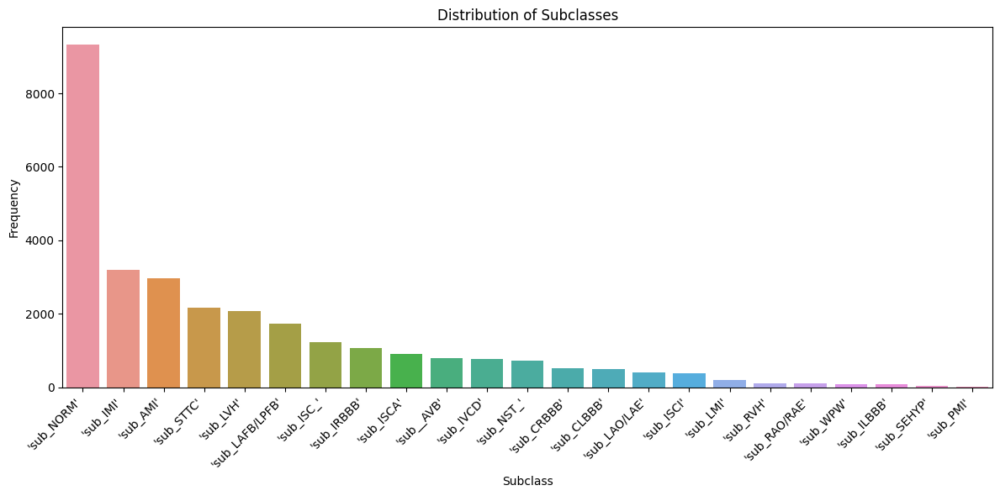

In [ ]:
# Plot the distribution of the subclasses
sns.set_palette('deep')

plt.figure(figsize=(12, 6))
sns.barplot(x='Subclass', y='Frequency', data=subclasses_df)
plt.xlabel('Subclass')
plt.ylabel('Frequency')
plt.title('Distribution of Subclasses')
plt.xticks(rotation=45, ha='right')  
plt.tight_layout() 
plt.show()



# Multivariate analysis <a name='multi'></a>

For this part, I will group and visualize the distribution of the superclasses and subclasses grouped by multiple variables.
Lets start to see the distribution of variables grouped by sex: 

<Figure size 1200x600 with 0 Axes>

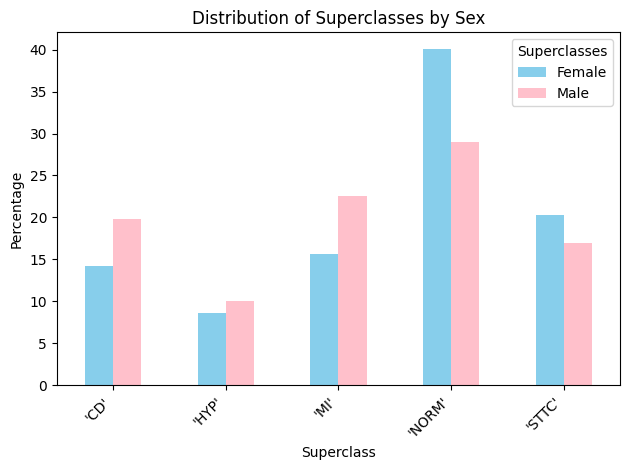

In [ ]:
# Convert values in diagnostic_superclass column to strings
Y['diagnostic_superclass'] = Y['diagnostic_superclass'].astype(str)

# Grouping superclass frequencies by sex and removing brackets
superclass_freq_by_sex = Y.groupby('sex')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts(normalize=True) * 100).unstack()

# There's one empty superclass, let's remove it
superclass_freq_by_sex = superclass_freq_by_sex.drop(columns='')
superclass_freq_by_sex = superclass_freq_by_sex.transpose()

# Plotting the distribution of superclasses by sex

plt.figure(figsize=(12, 6))
superclass_freq_by_sex.plot(kind='bar', color=['skyblue', 'pink'])
plt.xlabel('Superclass')
plt.ylabel('Percentage')
plt.title('Distribution of Superclasses by Sex')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.legend(title='Superclasses')
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


The grouped distribution of superclass categories demonstrates similarities, albeit with a notable predominance of normal ECGs among the female population. This discrepancy could introduce bias in future predictions, potentially leading models to favor normal ECGs specifically for this demographic. This issue gains particular relevance considering that cardiovascular disease (CVD) stands as the leading cause of death in women, surpassing all other causes combined annually [8]. While CVD is more prevalent in men below 40 years, the prevalence evens out between genders after 40, with elderly women (>60 years) exhibiting even higher CVD rates than men, an alarming reality often overlooked by physicians[9].

Additionally, recent research underscores physicians' ongoing under-recognition of cardiovascular disease in women, coupled with less extensive testing and more conservative management of CVD when identified [10]. This disparity in healthcare practices might contribute to the differences in percentages of normal and anomalous EKGs seen in the PTB XL dataset. Consequently, considering that the dataset predominantly represents an older demographic (with a mean age of 59 years), models developed within it may tend to underestimate subtle EKG changes in this population.

Now, lets observe the distribution grouped by 10 year intervals.

C:\Users\julia\AppData\Local\Temp\ipykernel_19480\2003921473.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  superclass_freq_by_age = Y.groupby('age_intervals')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts(normalize=True) * 100).unstack()


<Figure size 1200x600 with 0 Axes>

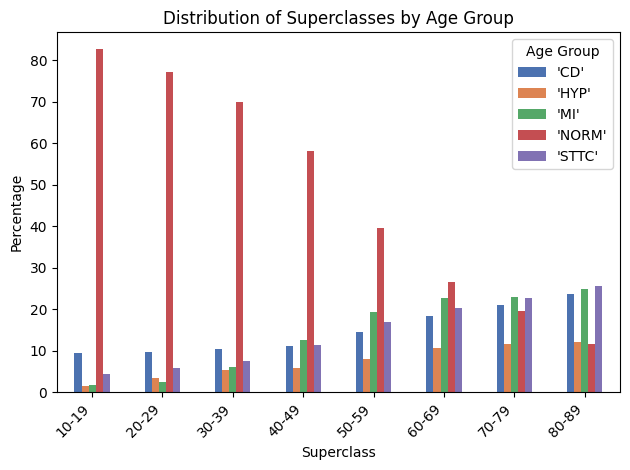

,'CD','HYP','MI','NORM','STTC'
age_intervals,,,,,
10-19,9.535452,1.466993,1.711491,82.640587,4.400978
20-29,9.793814,3.505155,2.577320,77.319588,5.979381
30-39,10.476788,5.395232,6.022585,70.012547,7.465496
40-49,11.070780,5.952813,12.740472,58.076225,11.433757
50-59,14.502405,7.972623,19.367370,39.585646,17.055124
60-69,18.363820,10.600605,22.814345,26.501512,20.221806
70-79,20.947718,11.697849,23.011016,19.706242,22.766218
80-89,23.660094,12.218828,24.798667,11.718967,25.631769


In [ ]:
# Grouping superclass frequencies by age group, in 10-year intervals

# Create the intervals for age groups from 0 to 100. 
age_bins = range(0, 101, 10)
age_labels = [f'{i}-{i+9}' for i in range(0, 100, 10)]

# Grouping superclass frequencies by age group, splitting the strings by comma and deleting the empty superclass
Y['age_intervals'] = pd.cut(Y['age'], bins=age_bins, labels=age_labels, right=False)
superclass_freq_by_age = Y.groupby('age_intervals')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts(normalize=True) * 100).unstack()
superclass_freq_by_age = superclass_freq_by_age.drop(columns='')

# Plotting the distribution of superclasses by age group 
plt.figure(figsize=(12, 6))
superclass_freq_by_age.plot(kind='bar')
plt.xlabel('Superclass')
plt.ylabel('Percentage')
plt.title('Distribution of Superclasses by Age Group')
plt.xticks(rotation=45, ha='right')  
plt.legend(title='Age Group')
plt.tight_layout()  
plt.show()
superclass_freq_by_age 

c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\julia\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning

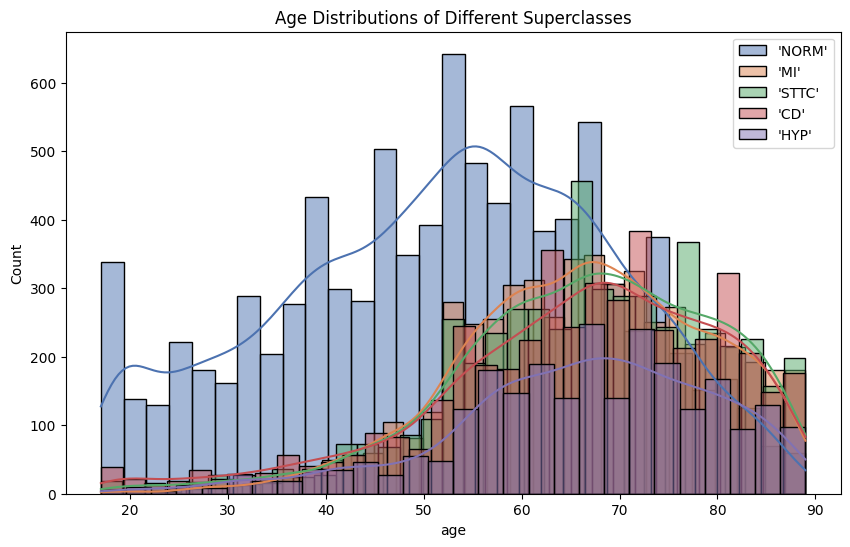

In [ ]:
# Remove empty superclass and split by commas
superclass_counts = Y['diagnostic_superclass'].str.strip('[]').str.split(',').explode().str.strip()

# Remove empty strings
superclass_counts = superclass_counts[superclass_counts != '']

# Get counts of each superclass
superclass_counts = superclass_counts.value_counts()

# Create the figure and subplot
fig, ax = plt.subplots(figsize=(10, 6))
plt.title('Age Distributions of Different Superclasses')

# Iterate through each superclass
for superclass, count in superclass_counts.items():
    data = Y[Y['diagnostic_superclass'].str.contains(superclass)]['age']  # Filter data for the current superclass
    sns.histplot(data, label=superclass, ax=ax, kde=True)  # Plot distribution on the same axis

plt.legend(loc='upper right')
plt.show()


Not surprisingly, the NORMAL superclass appears to be more prevalent among younger patients, whereas the other superclasses exhibit higher frequencies in older patients. Lets continue with the 'nurse' category. 

            'CD'      'HYP'       'MI'     'NORM'     'STTC'
nurse                                                       
0.0    16.046556   9.425682  22.362145  32.551040  17.095974
1.0    20.064543   7.464571  20.275011  33.127543  18.268556
2.0     8.597285   2.564103   5.580694  76.319759   6.184012
3.0    17.385943  11.590629  14.056720  34.278668  22.318126
4.0    17.369093  10.600255  15.325670  34.738186  21.583653
5.0    15.671642  11.691542  15.547264  34.079602  22.512438
6.0    14.340589  10.755442  16.389245  35.851472  21.895006
7.0    16.848485  11.757576  16.242424  34.545455  20.000000
8.0    16.253102  11.414392  16.749380  34.987593  19.975186
9.0    17.396907  10.180412  16.494845  36.082474  19.072165
10.0   17.125000  11.000000  15.750000  35.250000  20.125000
11.0   16.410256  12.179487  13.076923  36.666667  20.897436


<Figure size 3000x1500 with 0 Axes>

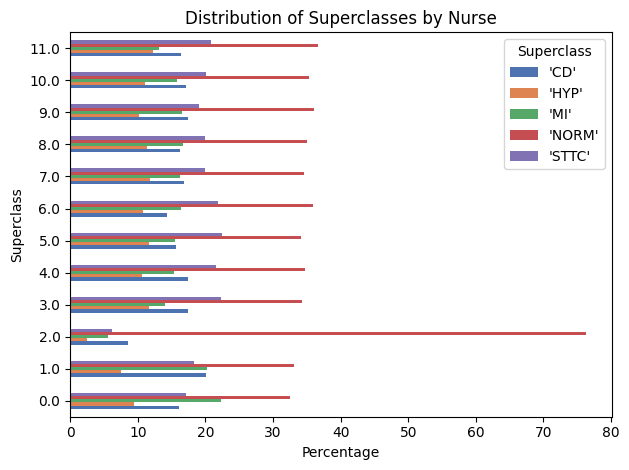

In [ ]:
# Grouping superclass frequencies by nurse
superclass_freq_by_nurse = Y.groupby('nurse')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts(normalize=True)*100).unstack()

# Deleting empty superclass
superclass_freq_by_nurse = superclass_freq_by_nurse.drop('', axis=1) 
print(superclass_freq_by_nurse)

# Plotting the distribution of superclasses by nurse
plt.figure(figsize=(30, 15))
superclass_freq_by_nurse.plot(kind='barh')  # Use 'barh' instead of 'bar'
plt.xlabel('Percentage')
plt.ylabel('Superclass')
plt.title('Distribution of Superclasses by Nurse')
plt.legend(title='Superclass')
plt.tight_layout()
plt.show()


Observation:
Please note that the percentages do not sum up to 100% due to the exclusion of the empty superclass, which was still recorded for some nurses.

It appears that nurse number 2 has an unusually high percentage of normal EKGs, even doubling that of all the other nurses, despite being the third in terms of the total number of EKGs recorded. This might be due to a number of reasons:

- Sampling Bias: There might be differences in the patient population each nurse is assigned to. Nurse number 2 might predominantly deal with younger, healthier patients.
-  Nurses may have varying levels of thoroughness or consistency in recording EKG data. Nurse number 2 might be more diligent in documenting normal EKGs compared to other nurses.



In [ ]:
# lets group nurse number 2 by the age of the patients they tended to 
nurse_2 = Y[Y['nurse'] == 2]
nurse_2['age_intervals'] = pd.cut(nurse_2['age'], bins=age_bins, labels=age_labels, right=False)
superclass_freq_by_age_nurse_2 = nurse_2.groupby('age_intervals')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts()).unstack()
superclass_freq_by_age_nurse_2 = superclass_freq_by_age_nurse_2.drop(columns='')


# add a total column to the dataframe
superclass_freq_by_age_nurse_2['Total'] = superclass_freq_by_age_nurse_2.sum(axis=1)
superclass_freq_by_age_nurse_2


C:\Users\julia\AppData\Local\Temp\ipykernel_19480\1949928009.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nurse_2['age_intervals'] = pd.cut(nurse_2['age'], bins=age_bins, labels=age_labels, right=False)
C:\Users\julia\AppData\Local\Temp\ipykernel_19480\1949928009.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  superclass_freq_by_age_nurse_2 = nurse_2.groupby('age_intervals')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts()).unstack()


,'CD','HYP','MI','NORM','STTC',Total
age_intervals,,,,,,
10-19,10.0,1.0,1.0,114.0,6.0,132.0
20-29,7.0,4.0,2.0,112.0,4.0,129.0
30-39,9.0,6.0,2.0,79.0,6.0,102.0
40-49,8.0,2.0,6.0,99.0,6.0,121.0
50-59,13.0,4.0,18.0,72.0,17.0,124.0
60-69,9.0,NaN,6.0,26.0,1.0,42.0
70-79,1.0,NaN,2.0,3.0,1.0,7.0
80-89,NaN,NaN,NaN,1.0,NaN,1.0


As evident from the data, nurse number 2 primarily attended to younger patients, with the highest patient count observed in the 10-19 age group. This demographic trend could potentially account for the higher number of Normal EKGs recorded by this nurse.

<Figure size 1500x1000 with 0 Axes>

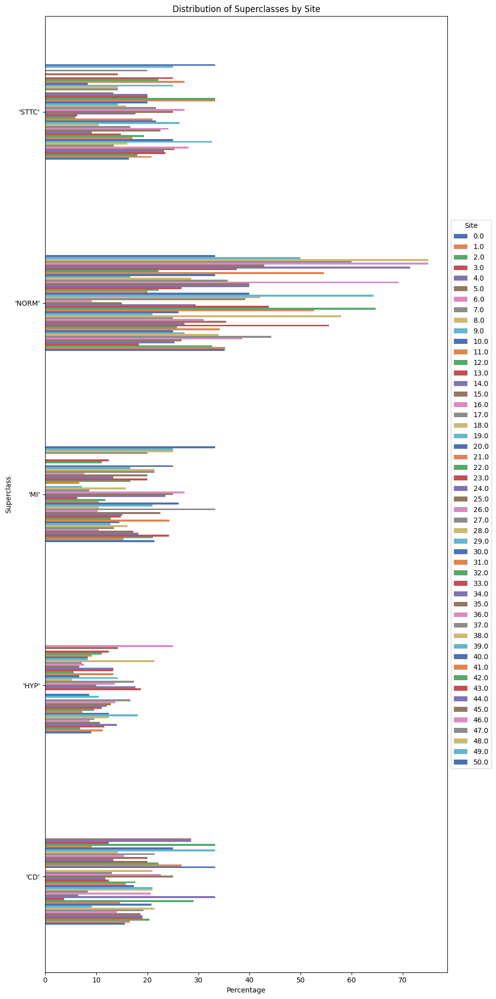

In [ ]:
# Grouping superclass frequencies by site
superclass_freq_by_site = Y.groupby('site')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts(normalize=True)*100).unstack()

# Deleting empty superclass
superclass_freq_by_site = superclass_freq_by_site.drop(columns='')
superclass_freq_by_site = superclass_freq_by_site.transpose()

# Plotting the distribution of superclasses by site
plt.figure(figsize=(15, 10))  # Adjust the figure size as needed
superclass_freq_by_site.plot(kind='barh', figsize=(10, 20))  # Use a horizontal bar plot for better readability
plt.xlabel('Percentage')
plt.ylabel('Superclass')
plt.title('Distribution of Superclasses by Site')
plt.legend(title='Site', loc='center left', bbox_to_anchor=(1, 0.5))  # Adjust legend position
plt.tight_layout()
plt.show()

Observation:
The recording sites seem to have a similar distribution of superclasses

<Figure size 2000x600 with 0 Axes>

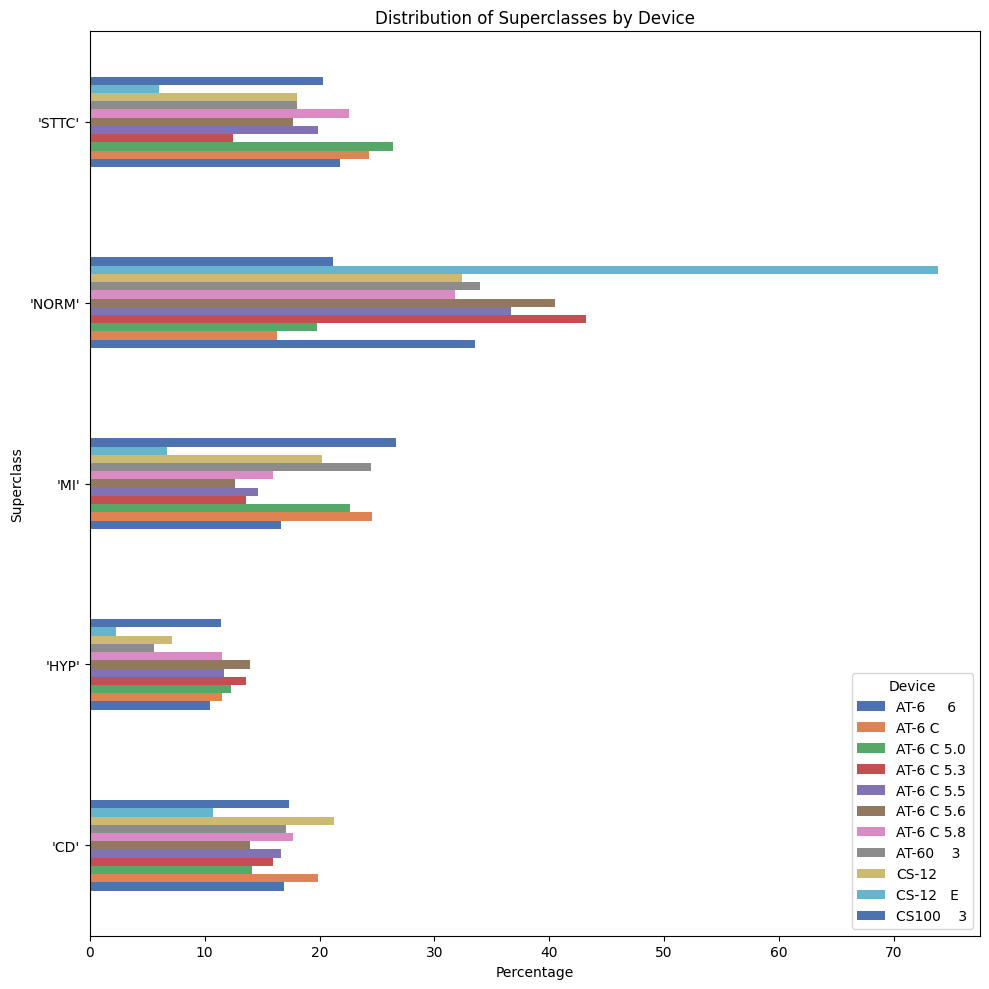

In [ ]:
# Grouping superclass frequencies by Device
superclass_freq_by_device = Y.groupby('device')['diagnostic_superclass'].apply(lambda x: x.str.strip('[]').str.split(',').explode().str.strip().value_counts(normalize=True)*100).unstack()

# Deleting empty superclass
superclass_freq_by_device = superclass_freq_by_device.drop(columns='')
superclass_freq_by_device = superclass_freq_by_device.transpose()

# Plotting the distribution of superclasses by Device
plt.figure(figsize=(20, 6))
superclass_freq_by_device.plot(kind='barh', figsize=(10, 10)) 
plt.xlabel('Percentage')
plt.ylabel('Superclass')
plt.title('Distribution of Superclasses by Device')
plt.legend(title='Device')
plt.tight_layout()
plt.show()

The CS-12 E device has a higher percentage of patients with the 'NORM' superclass.

Now, lets analyze each subclass included in the superclassess and their frequency

In [ ]:
# Define the dictionary of superclasses and possible subclasses. This information is available in the dataset documentation. 
sub_sup_dict = {
    'NORM': 'sub_NORM',
    'CD': ['sub_LAFB/LPFB', 'sub_IRBBB', 'sub_CLBBB', 'sub_CRBBB', 'sub__AVB', 'sub_IVCB', 'sub_WPW'],
    'HYP': ['sub_LVH', 'sub_RHV', 'sub_LAO/LAE', 'sub_RAO/RAE', 'sub_SEHYP'],
    'MI': ['sub_AMI', 'sub_IMI', 'sub_LMI', 'sub_PMI'],
    'STTC': ['sub_ISCA', 'sub_ISCI', 'sub_ISC_', 'sub_STTC', 'sub_NST_']
}

# Lets create a dataframe with the superclass and subclass columns
sub_sup= Y[['sex','diagnostic_superclass', 'diagnostic_subclass']].copy().astype(str)

#First, delete brackets
sub_sup['diagnostic_subclass'] = sub_sup['diagnostic_subclass'].str.strip('[]')
sub_sup['diagnostic_superclass'] = sub_sup['diagnostic_superclass'].str.strip('[]')
sub_sup.head()

,sex,diagnostic_superclass,diagnostic_subclass
ecg_id,,,
1,Female,'NORM','sub_NORM'
2,Male,'NORM','sub_NORM'
3,Female,'NORM','sub_NORM'
4,Male,'NORM','sub_NORM'
5,Female,'NORM','sub_NORM'


Lets plot the subclasses

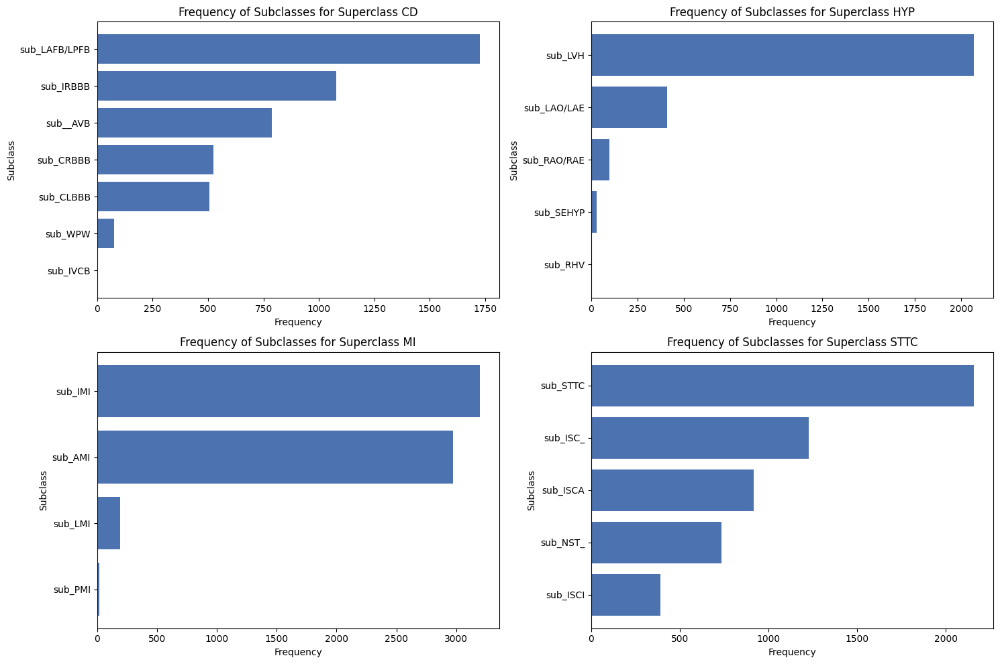

In [ ]:
# I am not going to include the superclass NORM, as it only has one subclass (NORM).

# Exclude the superclass "NORM"
superclasses = [key for key in sub_sup_dict.keys() if key != 'NORM']

# Calculate the number of rows and columns for subplots
num_rows = (len(superclasses) + 1) // 2  # Add 1 and then divide by 2 to ensure enough rows
num_cols = 2  # Two columns for subplots

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Flatten the axes array for easier iteration
axs = axs.flatten()

# Iterate through each superclass
for i, key in enumerate(superclasses):
    possible_subclasses = sub_sup_dict[key]
    subclass_freq = {}
    
    # Count the frequency of each subclass
    for subclass in possible_subclasses:
        subclass_freq[subclass] = sub_sup[sub_sup['diagnostic_subclass'].str.contains(subclass)].shape[0]
    
    # Sort subclass frequencies by frequency values in ascending order
    sorted_subclass_freq = dict(sorted(subclass_freq.items(), key=lambda item: item[1]))
    
    # Plot the bar graph for the current superclass
    axs[i].barh(list(sorted_subclass_freq.keys()), sorted_subclass_freq.values())
    axs[i].set_xlabel('Frequency')
    axs[i].set_ylabel('Subclass')
    axs[i].set_title(f'Frequency of Subclasses for Superclass {key}')

plt.tight_layout()
plt.show()


For CD (Conduction Disturbances), the most common subclass is LAFB/LPFB (left anterior/left posterior fascicular block). The least common subclass is IVCB (intraventricular conduction block), which had no instances in the dataset. Future models won't be able to detect this abnormality if it occurs. Similarly, the HYP subclass RHV (right heart ventricular hypertrophy) had no instances in the dataset.

MI (Myocardial Infarction) exhibits the most common subclass as IMI (inferior myocardial infarction), whereas the least common subclass is PMI (posterior myocardial infarction). This aligns well with reality since inferior infarctions account for 40% of all myocardial infarctions, while posterior infarctions are the least common. The incidence of isolated posterior MI has been reported at about 3.3% using posterior leads, though this may still be an underestimate as posterior leads are not routinely employed [10].

STTC (ST-T Changes) has the most common subclass as ST-T changes, while the least common subclass is ISCI.

Now, lets sort the subclasses by sex: 

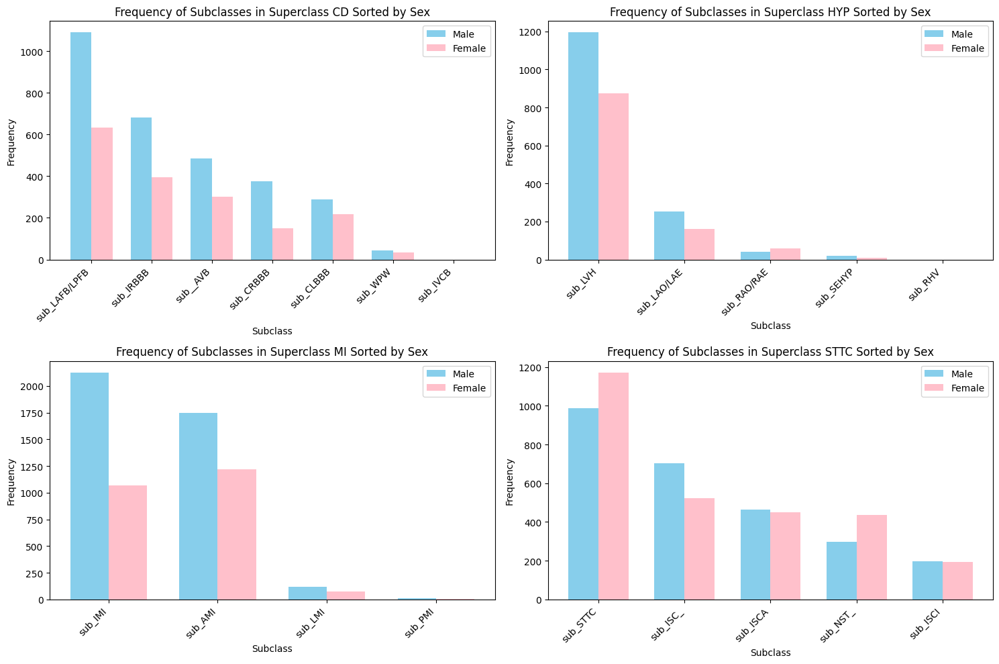

In [ ]:
# Exclude the superclass "NORM"
superclasses = [key for key in sub_sup_dict.keys() if key != 'NORM']

# Calculate the number of rows and columns for subplots
num_rows = (len(superclasses) + 1) // 2  
num_cols = 2  

# Create subplots and flatten the axes array
fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
axs = axs.flatten()

# Iterate through each superclass
for i, key in enumerate(superclasses):
    # Initialize a dictionary to store subclass frequencies for each sex
    subclass_freq_by_sex = {'Male': {}, 'Female': {}}

    # Populate subclass frequencies for each sex
    for sex_value in sub_sup['sex'].unique():
        subclass_freq = {}
        for subclass in sub_sup_dict[key]:
            subclass_freq[subclass] = sub_sup[(sub_sup['diagnostic_subclass'].str.contains(subclass)) & (sub_sup['sex'] == sex_value)].shape[0]
        subclass_freq_by_sex[sex_value] = subclass_freq

    # Convert dictionary to DataFrame
    subclass_freq_df = pd.DataFrame(subclass_freq_by_sex)

    # Sort DataFrame by subclass frequency in descending order
    subclass_freq_df.sort_values(by='Male', ascending=False, inplace=True)

    # Plot the subclass frequencies for each sex in the subplot
    bar_width = 0.35
    index = range(len(subclass_freq_df))

    axs[i].bar(index, subclass_freq_df['Male'], bar_width, label='Male', color='skyblue')
    axs[i].bar([j + bar_width for j in index], subclass_freq_df['Female'], bar_width, label='Female', color='pink')

    axs[i].set_xlabel('Subclass')
    axs[i].set_ylabel('Frequency')
    axs[i].set_title(f'Frequency of Subclasses in Superclass {key} Sorted by Sex')
    axs[i].set_xticks([k + bar_width / 2 for k in index])
    axs[i].set_xticklabels(subclass_freq_df.index, rotation=45, ha='right')
    axs[i].legend()

# Remove any empty subplots
for j in range(len(superclasses), num_rows * num_cols):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()


Males had a higher frequency in almost every subclass, except for the subclass STTC and NST (Non-specific T wave changes), which is still consistent with the overall distribution of the superclasses.



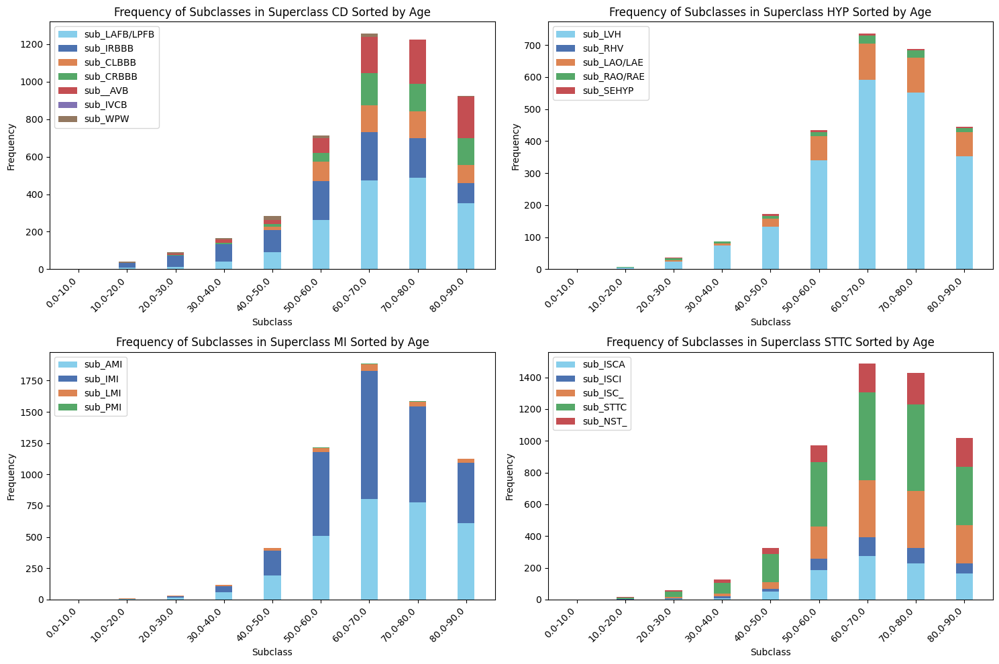

In [ ]:
# Exclude the superclass "NORM"
superclasses = [key for key in sub_sup_dict.keys() if key != 'NORM']

# Calculate the number of rows and columns for subplots
num_rows = (len(superclasses) + 1) // 2  
num_cols = 2  

# Lets add the age column to the dataframe
sub_sup["age"] = Y["age"]

# Define the age intervals
age_intervals = np.arange(0, sub_sup['age'].max() + 10, 10)

# Create subplots and flatten the axes array
fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
axs = axs.flatten()

# Iterate through each superclass
for i, key in enumerate(superclasses):
    # Initialize a dictionary to store subclass frequencies for each age interval
    subclass_freq_by_age = {}

    # Populate subclass frequencies for each age interval
    for age_start, age_end in zip(age_intervals[:-1], age_intervals[1:]):
        subclass_freq = {}
        for subclass in sub_sup_dict[key]:
            subclass_freq[subclass] = sub_sup[(sub_sup['diagnostic_subclass'].str.contains(subclass)) & 
                                              (sub_sup['age'] >= age_start) & (sub_sup['age'] < age_end)].shape[0]
        subclass_freq_by_age[f'{age_start}-{age_end}'] = subclass_freq

    # Convert dictionary to the dataframe format
    subclass_freq_df = pd.DataFrame(subclass_freq_by_age)

    # Plot the subclass frequencies for each age interval in the subplot
    bar_width = 0.35
    index = range(len(subclass_freq_df.columns))

    axs[i].bar(index, subclass_freq_df.iloc[0], bar_width, label=subclass_freq_df.index[0], color='skyblue')
    bottom = subclass_freq_df.iloc[0]
    for j in range(1, len(subclass_freq_df)):
        axs[i].bar(index, subclass_freq_df.iloc[j], bar_width, bottom=bottom, label=subclass_freq_df.index[j])
        bottom += subclass_freq_df.iloc[j]

    axs[i].set_xlabel('Subclass')
    axs[i].set_ylabel('Frequency')
    axs[i].set_title(f'Frequency of Subclasses in Superclass {key} Sorted by Age')
    axs[i].set_xticks(index)
    axs[i].set_xticklabels(subclass_freq_df.columns, rotation=45, ha='right')
    axs[i].legend()

# Remove any empty subplots
for j in range(len(superclasses), num_rows * num_cols):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()


As anticipated, older patients exhibited a higher frequency across every subclass. This further strengthens the notion that this dataset will be highly beneficial for distinguishing between normal and abnormal ECGs in the elderly population.

# EDA automatic profile report: <a name='auto'></a>

 Next we will create a profile report for the data. The function calculates the correlation between the variables, the distribution of the data, the missing values, and the cardinality of the data.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)
c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\ydata_profiling\model\missing.py:78: UserWarning: There was an attempt to generate the Heatmap missing values diagrams, but this failed.
To hide this warning, disable the calculation
(using `df.profile_report(missing_diagrams={"Heatmap": False}`)
If this is problematic for your use case, please report this as an issue:
https://github.com/ydataai/ydata-profiling/issues
(include the error message: 'could not convert string to float: '--'')
  warnings.warn(


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

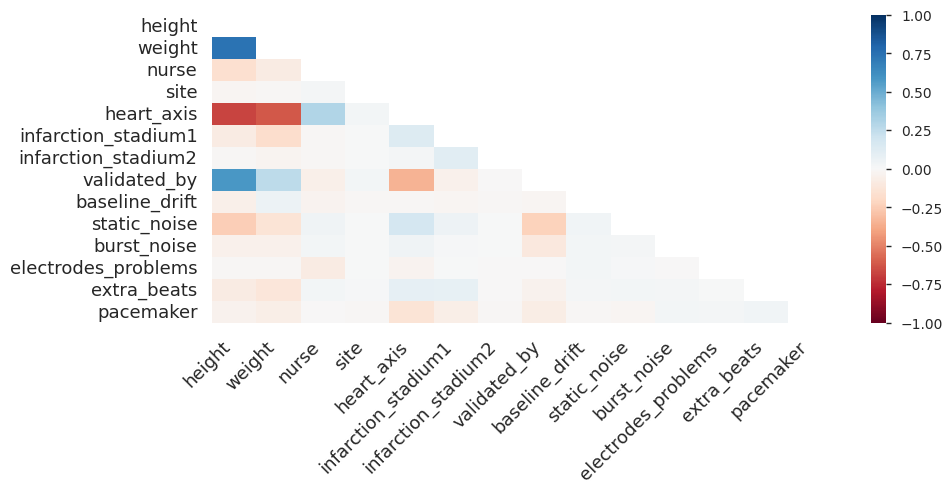

In [14]:

profile = ProfileReport(Y, title='Pandas Profiling Report', explorative=True, correlations={'auto': {'calculate': False}})

profile.to_widgets()


This heatmap illustrates the correlation between variables in the dataset. The correlation coefficient ranges from -1 to 1, where a value close to 1 indicates a strong positive correlation, implying that the variables tend to increase together. Conversely, a value close to -1 signifies a strong negative correlation, indicating that one variable tends to decrease as the other increases. A correlation coefficient close to 0 suggests no significant correlation between the variables.

In our dataset, a notable finding is a strong negative correlation between the heart axis and both height and weight. However, for the remainder of the dataset, there appears to be no other significant correlation observed among the quantitative variables.

# Final EKG sample: <a name='samples'></a>

Finally, as an exercise, we are going to take 3 patients out of each category and graph the 10 seconds of raw waves so we can see the dataset we are working with. 

In [ ]:
Y_copy2 = Y_copy.copy().astype(str)
Y_copy2['diagnostic_superclass'] = Y_copy2['diagnostic_superclass'].astype(str)
superclasses = ("['NORM']", "['CD']", "['HYP']", "['MI']", "['STTC']")

# Initialize superclass_store dictionary outside the loop
superclass_store = {superclass: [] for superclass in superclasses}

for i, x in enumerate(Y_copy2['diagnostic_superclass']):
    if x in superclasses:  # Check if the superclass is in the list above  and store the superclass index
        superclass_store[x].append(i)

# Print a small sample of the stored superclasses and their indices
print({superclass: indices[:5] for superclass, indices in superclass_store.items()})


{"['NORM']": [0, 1, 2, 3, 4], "['CD']": [31, 40, 48, 51, 64], "['HYP']": [29, 95, 136, 305, 325], "['MI']": [7, 62, 130, 145, 147], "['STTC']": [21, 25, 27, 47, 53]}


Superclass: ['NORM'], Selected Indices: [8472, 16975, 4021]


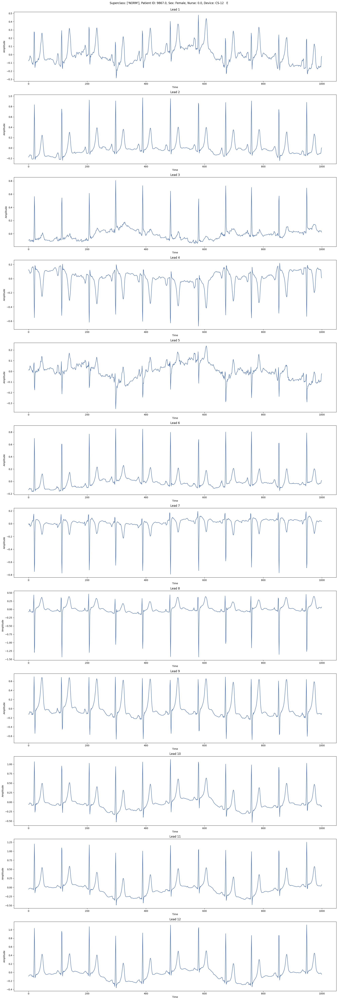

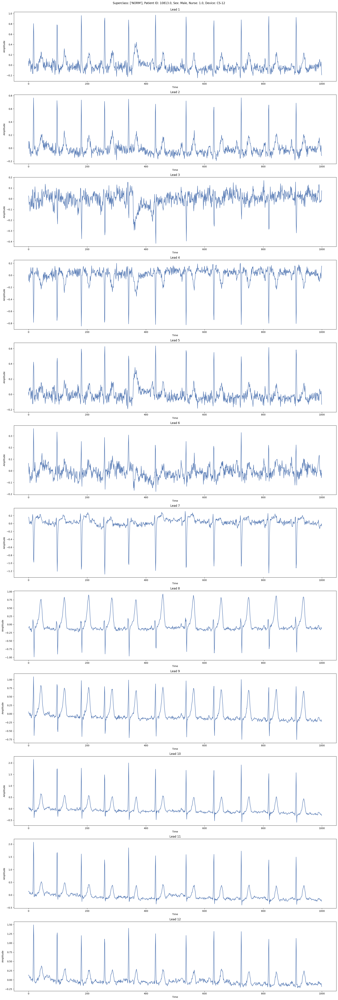

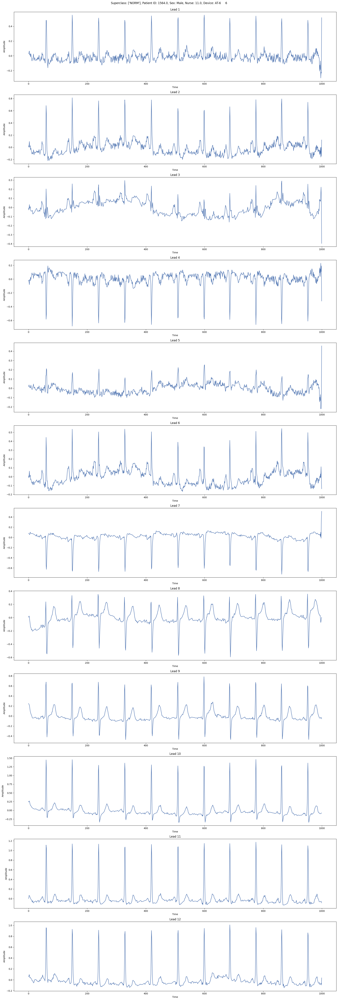

Superclass: ['CD'], Selected Indices: [8354, 15873, 18646]


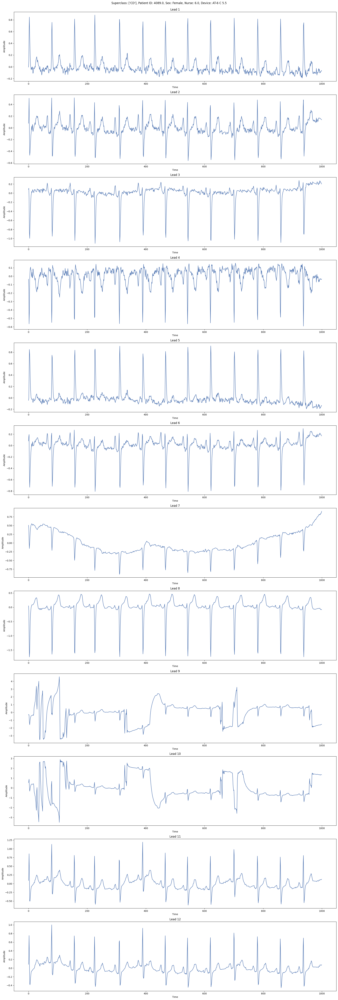

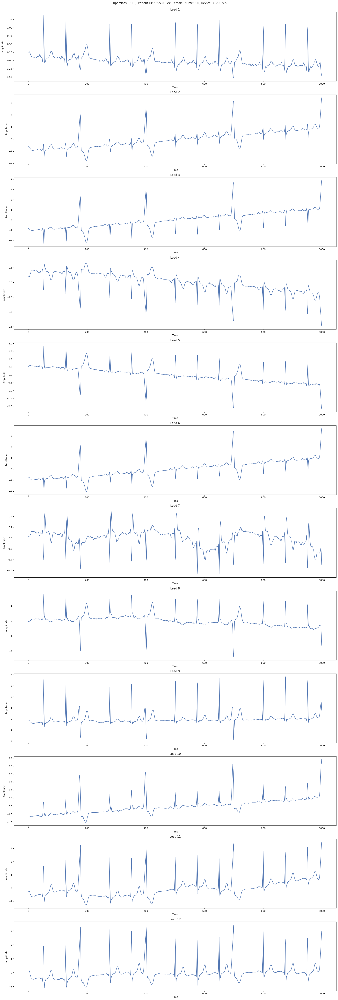

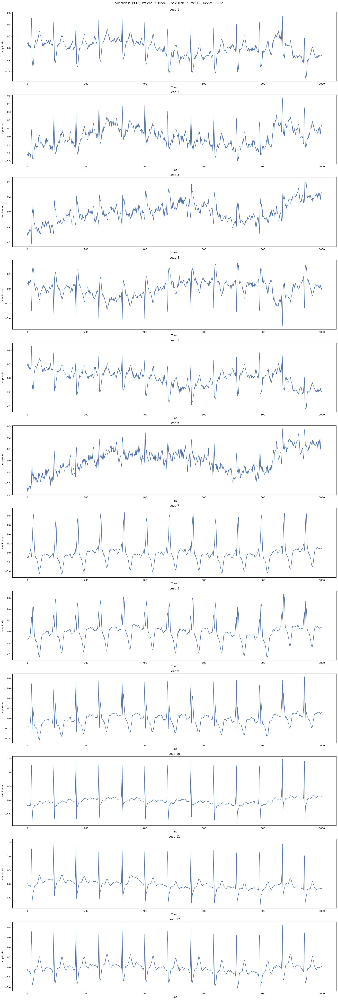

Superclass: ['HYP'], Selected Indices: [13955, 11194, 2763]


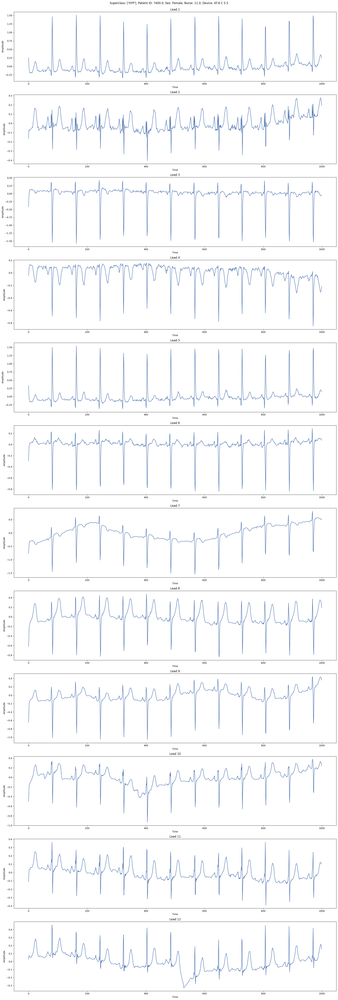

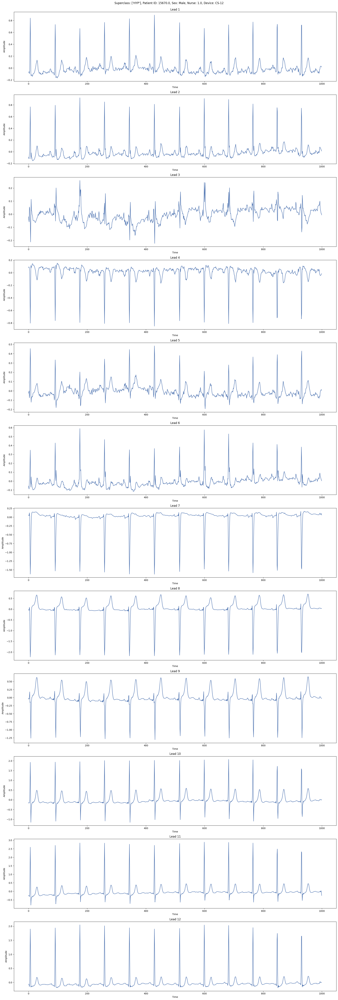

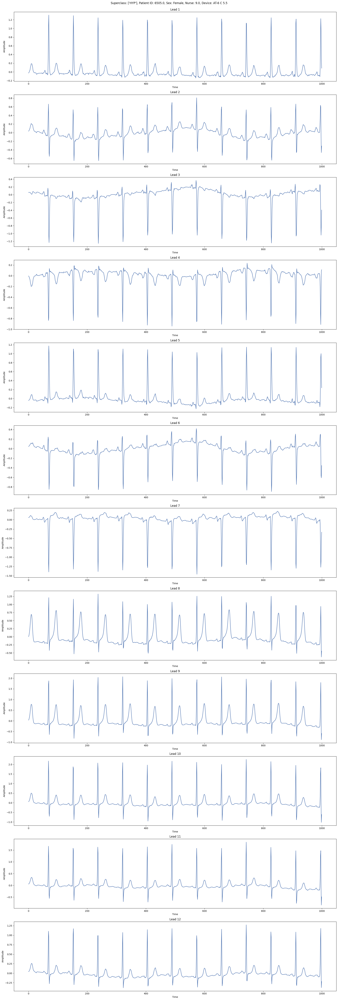

Superclass: ['MI'], Selected Indices: [2547, 12838, 13100]


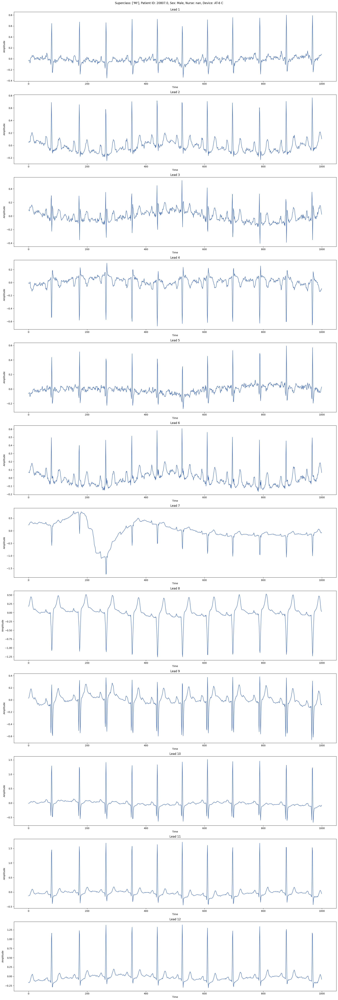

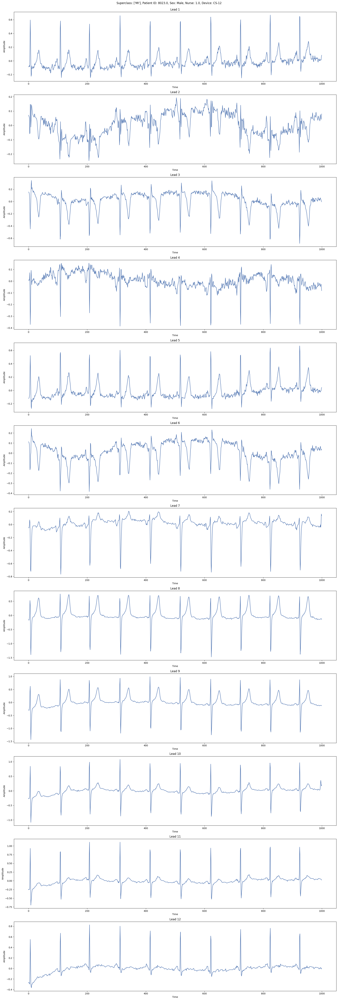

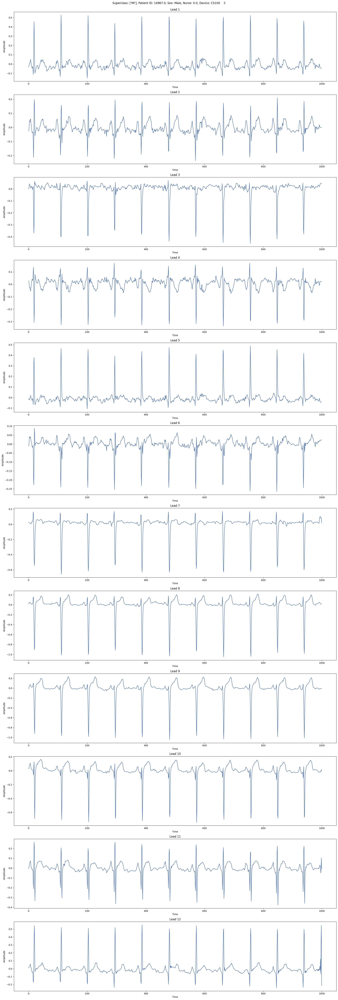

Superclass: ['STTC'], Selected Indices: [14356, 20240, 20785]


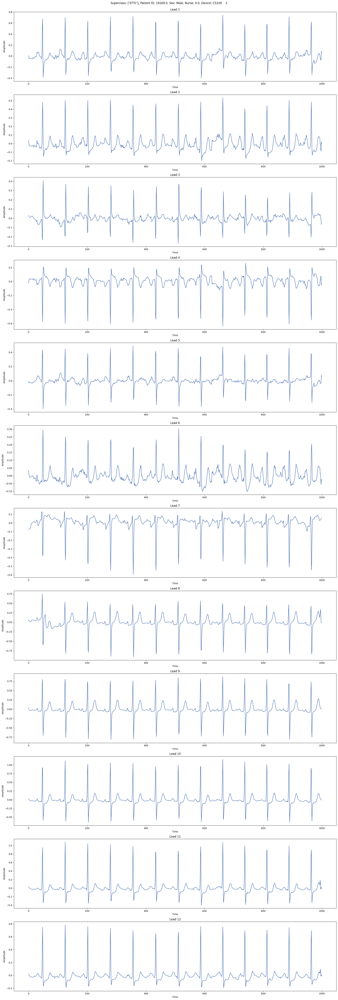

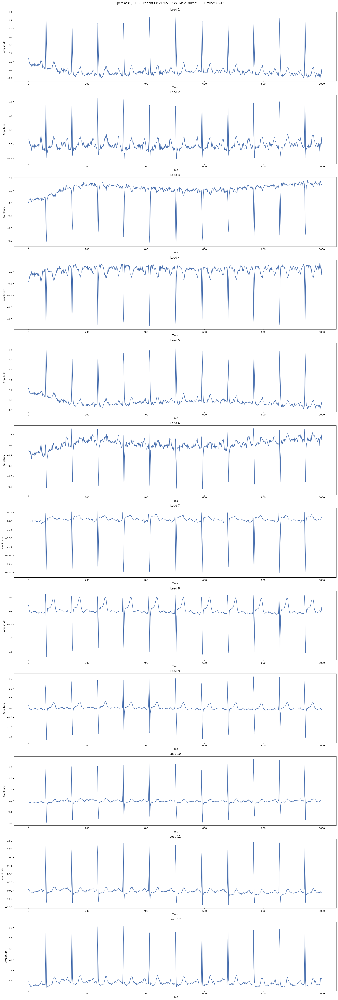

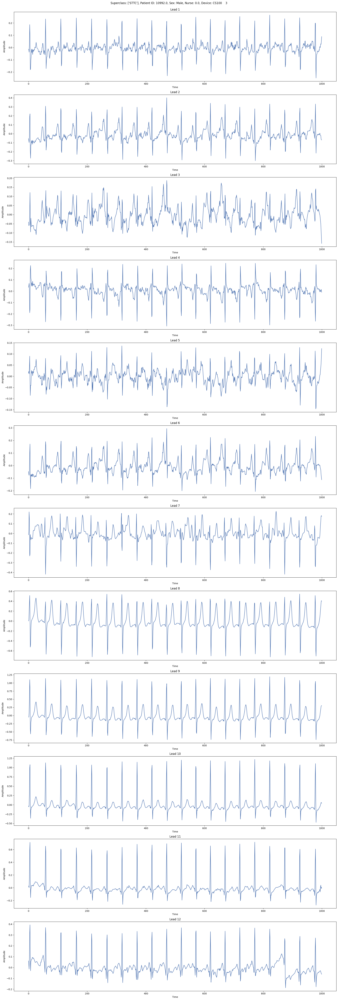

In [ ]:
# Define the number of random records to select for each superclass
num_records_per_superclass = 3

# Define the number of leads
num_leads = 12

# Iterate through each key in the superclass_store dictionary
for superclass, indices_list in superclass_store.items():
    # Randomly select three indices for the current superclass
    selected_indices = random.sample(indices_list, num_records_per_superclass)
    print(f'Superclass: {superclass}, Selected Indices: {selected_indices}')
    # Iterate through each selected index
    for index in selected_indices:
        # Retrieve the raw wave record from X
        raw_wave_record = X[index]
        
        # Retrieve the metadata (patient_id, sex, nurse, device) from Y_copy
        metadata = Y_copy.iloc[index]  
        superclass = metadata['diagnostic_superclass']
        patient_id = metadata['patient_id']
        sex = metadata['sex']
        nurse = metadata['nurse']
        device = metadata['device']
        
        # Plot each lead in a separate subplot
        fig, axs = plt.subplots(num_leads, 1, figsize=(20, 5 * num_leads))
        for lead_index in range(num_leads):
            axs[lead_index].plot(raw_wave_record[:, lead_index])
            axs[lead_index].set_title(f'Lead {lead_index + 1}')
            axs[lead_index].set_xlabel('Time')
            axs[lead_index].set_ylabel('Amplitude')
        fig.suptitle(f'Superclass: {superclass}, Patient ID: {patient_id}, Sex: {sex}, Nurse: {nurse}, Device: {device}')
        plt.tight_layout()  # Adjust layout to minimize overlapping elements
        plt.subplots_adjust(top=0.97) 
        plt.show()


As we can see, each record does correspond to a 12 lead EKG. Theres some baseline interference in multiple records, which can be cleaned by filtering the signal annotations. 


# ML modeling <a name='ML'></a>

As a test, I will attempt to create a random forest model with the training sets that the authors recommended.

In [ ]:

import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.decomposition import PCA

# Flatten the input data
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

# Flatten the nested lists in y_train and y_test
y_train_flat = np.array([label[0] if label else None for label in y_train])
y_test_flat = np.array([label[0] if label else None for label in y_test])

# Create DataFrame to filter out NaN values
train_df = pd.DataFrame({'X_train_flat': list(X_train_flat), 'y_train_flat': y_train_flat})
test_df = pd.DataFrame({'X_test_flat': list(X_test_flat), 'y_test_flat': y_test_flat})

# Remove rows with NaN values in the target labels
train_df = train_df.dropna(subset=['y_train_flat'])
test_df = test_df.dropna(subset=['y_test_flat'])

# Limit the number of samples for training and testing
train_df = train_df.sample(n=10000, random_state=42)
test_df = test_df.sample(n=2000, random_state=42)

# Retrieve filtered X_train_flat and y_train_flat
X_train_filtered = np.array(train_df['X_train_flat'].tolist())
y_train_filtered = np.array(train_df['y_train_flat'])

# Retrieve filtered X_test_flat and y_test_flat
X_test_filtered = np.array(test_df['X_test_flat'].tolist())
y_test_filtered = np.array(test_df['y_test_flat'])

# Verify the shape of filtered data
print("X_train_filtered shape:", X_train_filtered.shape)
print("y_train_filtered shape:", y_train_filtered.shape)
print("X_test_filtered shape:", X_test_filtered.shape)
print("y_test_filtered shape:", y_test_filtered.shape)

# Initialize PCA with a smaller number of components
pca = PCA(n_components=50)  # Adjust the number of components as needed

# Fit PCA on the training data and transform both training and test data
X_train_pca = pca.fit_transform(X_train_filtered)
X_test_pca = pca.transform(X_test_filtered)

# Initialize RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model on the training data
rf_classifier.fit(X_train_pca, y_train_filtered)

# Predict the target labels for the test data
y_pred = rf_classifier.predict(X_test_pca)

# Evaluate the model's performance
accuracy = accuracy_score(y_test_filtered, y_pred)
print("Accuracy:", accuracy)


X_train_filtered shape: (10000, 12000)
y_train_filtered shape: (10000,)
X_test_filtered shape: (2000, 12000)
y_test_filtered shape: (2000,)
Accuracy: 0.4815


Data Preprocessing for Random Forest

To accommodate the Random Forest model's limitations, the data underwent specific preprocessing steps. Flattening the data structure was necessary as nested lists are not accepted by the model. Additionally, NaN values within the target labels were removed due to incompatibility with the model. Finally, computational limitations necessitated reducing the training and testing sample sizes. This constraint also influenced the number of principal components retained during PCA. Notably, PCA was performed solely on the training data, and the resulting components were used to transform both training and testing sets to ensure consistency.

Initial Random Forest Model

This initial model utilizes the cross-validation folds suggested by the study's authors. A Random Forest was chosen due to its strengths in handling large and complex datasets, particularly those with significant variations. This characteristic makes it robust to overfitting and well-suited to the intricate waveform data of electrocardiograms (EKGs). 
The resulting accuracy is markedly low, and has a lot of room for improvement. This might be due to the smaller samples I used due to my computer. Feature engineering and playing with the hyperparameters might be useful to get a better accuracy.

Model Considerations and Limitations

While this Random Forest serves as a valuable starting point, I acknowledge that more advanced models might be better suited for the task. For multi-label classification of ECG abnormalities in waveform data, deep learning architectures like Convolutional Neural Networks (CNNs) would likely demonstrate superior performance. CNNs excel at working with highly complex datasets, and extracting spatial features from sequential data like ECG signals. However, their implementation requires more extensive computational resources than what is currently available to me.


# *Conclusions:* <a name='conc'></a>

**Recommendations for Predictions:**

- I do not recommend using this dataset for predicting outcomes in individuals with pacemakers or for classifying stages of infarction. The pacemaker category exhibits multiple entries with uncertainties and lacks clarity.

**Considerations for Future Datasets:**

- Future datasets should include symptom registries as they may provide relevant information for predictive modeling.

**Demographic Insights:**

- The dataset predominantly represents an elderly population, with an average age of 59 years. Use with caution for younger populations. 
- Women in the dataset tend to report more "normal" findings despite having a higher prevalence of cardiovascular disease in real life. Caution is advised when making predictions for women, and clinical judgment should accompany any model predictions.

**Data Quality:**

- It's important to note that not all records have perfect baselines. Eliminating all the imperfect records in the database is possible, as it was recommended by the authors, but it could detrimentally affect predictions, as not all records in real clinical practice are perfect either. 

**Feature Considerations for Future Models:**

- Future models should include the raw signal, age, sex, weight, height, nurse, device, and site as features.
- While the report column should be saved as metadata, it should not be taken as a feature,due to its annotation in three different languages, which may complicate understanding.

**Target Variables:**

- I suggest using the SCP statements, diagnostic superclasses, and subclasses as target variables for predictive modeling purposes.

**Prediction Models**
- For multi label superclass and subclass prediction, I would suggest using Convoluted Neural Networks.


# References  <a name='ref'></a>

1. Wagner P, Strodthoff N, Bousseljot R, Samek W, Schaeffter T. PTB-XL, a large publicly available electrocardiography dataset (version 1.0.3). PhysioNet. 2022. [cited 2024 Mar 30]
Wagner P, Strodthoff N, Bousseljot RD, Kreiseler D, Lunze FI, Samek W, Schaeffter T. PTB-XL: A Large Publicly Available ECG Dataset. Scientific Data. 2020;7(1):10.1038/s41597-020-0495-6. [cited 2024 Mar 30]
1. Goldberger AL, Amaral LAN, Glass L, Hausdorff JM, Ivanov PC, Mark RK, Mietus JE, Moody GB, Peng CK, Stanley HE. PhysioBank, PhysioToolkit, and PhysioNet: Components of a new research resource for complex physiologic signals. Circulation. 2000;101(23):e215-e220. [cited 2024 Mar 30]
1. Statista. Life expectancy in Germany from 1881 to 2019 and a forecast until 2021 (in years). 2023 [cited 2024 Mar 30]. Available from: https://www.statista.com/statistics/1041098/life-expectancy-germany-all-time/
1. Centers for Disease Control and Prevention. FastStats - Life Expectancy. 2024 [cited 2024 Mar 30]. Available from: https://www.cdc.gov/nchs/fastats/life-expectancy.html
1. Lindman R, Aboyans V, Gupta D, et al. Cardiovascular care of older adults. [PubMed] 2022;34465575. [cited 2024 Mar 30]
1. Selvester RH, Singh SP, Blewitt DG. A method for signal quality assessment in Holter electrocardiograms. Physiol Meas. 1992;13(6):643-658. [cited 2024 Mar 30]
1. Piccirillo G, Inglese M, Mencarini A, et al. An alternative strategy for baseline wander correction in ECG signals. J Electrocardiol. 2010;43(5):449-456. [cited 2024 Mar 30]
1. Pezzin LE, Keyl PM, Green GB. Disparities in the emergency department evaluation of chest pain patients. Acad Emerg Med. 2007;14(2):149-156. [cited 2024 Mar 30]
1. Kaul P, Chang WC, Westerhout CM, Graham MM, Armstrong PW. Differences in admission rates and outcomes between men and women presenting to emergency departments with coronary syndromes. CMAJ. 2007;177(12):1193-1199. [cited 2024 Mar 30]
1. Thygesen K, Alpert JS, Jaffe AS, et al. Fourth Universal Definition of Myocardial Infarction (2018). J Am Coll Cardiol. 2018;72(20):2231-2264. [cited 2024 Mar 30]